SZ_Lyn-0001_reduced.fit -> Flusso: 944756.84
SZ_Lyn-0002_reduced.fit -> Flusso: 948214.47
SZ_Lyn-0003_reduced.fit -> Flusso: 773319.93
SZ_Lyn-0004_reduced.fit -> Flusso: 905728.96
SZ_Lyn-0005_reduced.fit -> Flusso: 913872.24
SZ_Lyn-0006_reduced.fit -> Flusso: 903679.84
SZ_Lyn-0007_reduced.fit -> Flusso: 906633.30
SZ_Lyn-0008_reduced.fit -> Flusso: 908457.72
SZ_Lyn-0009_reduced.fit -> Flusso: 727356.15
SZ_Lyn-0010_reduced.fit -> Flusso: 895126.21
SZ_Lyn-0011_reduced.fit -> Flusso: 891910.23
SZ_Lyn-0012_reduced.fit -> Flusso: 754141.74
SZ_Lyn-0013_reduced.fit -> Flusso: 877759.72
SZ_Lyn-0014_reduced.fit -> Flusso: 863233.71
SZ_Lyn-0015_reduced.fit -> Flusso: 861836.95
SZ_Lyn-0016_reduced.fit -> Flusso: 867512.16
SZ_Lyn-0017_reduced.fit -> Flusso: 862480.63
SZ_Lyn-0018_reduced.fit -> Flusso: 861956.87
SZ_Lyn-0019_reduced.fit -> Flusso: 854890.56
SZ_Lyn-0020_reduced.fit -> Flusso: 817267.82
SZ_Lyn-0021_reduced.fit -> Flusso: 832493.42
SZ_Lyn-0022_reduced.fit -> Flusso: 805415.78
SZ_Lyn-002

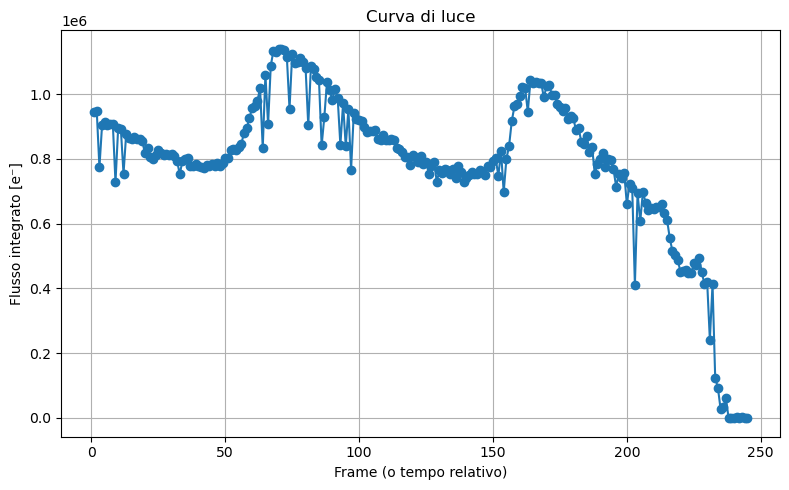

In [7]:
import os
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
import re

# --- FUNZIONI DI BASE ---

def load_reduced_image(filepath):
    # Apre un file FITS e restituisce i dati come un array NumPy di tipo float64
    with fits.open(filepath) as hdul:
        return hdul[0].data.astype(np.float64)

def extract_subimage(image, x_range, y_range):
    # Estrae una porzione dell'immagine originale in base agli intervalli x_range e y_range
    # x_range: intervallo di colonne (x)
    # y_range: intervallo di righe (y)
    return image[y_range[0]:y_range[1], x_range[0]:x_range[1]]

def create_circular_mask(shape, center, radius):
    # Crea una maschera circolare booleana centrata su `center` con raggio `radius`
    # La maschera è un array con valori True all'interno del cerchio e False all'esterno
    rows, cols = np.ogrid[:shape[0], :shape[1]]
    y, x = center
    mask = (rows - y)**2 + (cols - x)**2 <= radius**2
    return mask

def aperture_photometry(subimage, radius, gain=0.82, read_noise=10):
    # Esegue una fotometria di apertura su una sottoimmagine
    # Trova il massimo della sottoimmagine (presumibilmente la posizione dell'oggetto)
    pos_max = np.unravel_index(np.nanargmax(subimage), subimage.shape)
    mask = create_circular_mask(subimage.shape, pos_max, radius)

    # Crea due immagini, una per il target (oggetto) e una per il background
    target = np.copy(subimage)
    bckg = np.copy(subimage)
    target[~mask] = np.nan  # Imposta a NaN i pixel fuori dalla maschera
    bckg[mask] = np.nan     # Imposta a NaN i pixel dentro la maschera

    # Converte i valori in elettroni
    target_flux = target * gain
    bckg_flux = bckg * gain

    # Calcola il flusso dell'oggetto come la somma dei pixel target meno la media del background
    object_flux = target_flux - np.nanmean(bckg_flux)

    # Restituisce la somma totale del flusso dell'oggetto
    return np.nansum(object_flux)

# --- CURVA DI LUCE ---
def light_curve_from_series(directory, prefix, suffix='_reduced.fit',
                            x_range=(550, 670), y_range=(800, 920), radius=15):
    # Estrae la curva di luce da una serie di file FITS nella directory specificata
    fluxes = []  # Lista per i flussi misurati
    frames = []  # Lista per i numeri dei frame (o tempo relativo)

    # Trova i file che corrispondono al prefisso e al suffisso, ordinati numericamente
    files = sorted([f for f in os.listdir(directory) if f.startswith(prefix) and f.endswith(suffix)],
                   key=lambda x: int(re.findall(r'\d+', x)[0]))

    # Per ogni file FITS trovato, carica l'immagine, esegue la fotometria e aggiungi i risultati
    for i, fname in enumerate(files):
        path = os.path.join(directory, fname)
        image = load_reduced_image(path)  # Carica l'immagine FITS
        subimage = extract_subimage(image, x_range, y_range)  # Estrai la sottoimmagine
        flux = aperture_photometry(subimage, radius)  # Calcola il flusso tramite fotometria

        fluxes.append(flux)  # Aggiungi il flusso alla lista
        frames.append(i + 1)  # Aggiungi il numero del frame alla lista (i+1 per partire da 1)

        print(f"{fname} -> Flusso: {flux:.2f}")  # Stampa il flusso calcolato per ogni file

    # Restituisce i numeri dei frame e i flussi misurati
    return frames, fluxes

def plot_light_curve(frames, fluxes):
    # Plotta la curva di luce (flusso vs. frame)
    plt.figure(figsize=(8, 5))
    plt.plot(frames, fluxes, marker='o', linestyle='-')  # Grafico della curva di luce
    plt.xlabel("Frame (o tempo relativo)")  # Etichetta asse x
    plt.ylabel("Flusso integrato [e⁻]")  # Etichetta asse y
    plt.title("Curva di luce")  # Titolo del grafico
    plt.grid(True)  # Mostra la griglia
    plt.tight_layout()  # Regola automaticamente i margini
    plt.show()  # Mostra il grafico

# --- ESEMPIO DI USO ---

if __name__ == "__main__":
    # Imposta la cartella di lavoro e il prefisso dei file da analizzare
    base_dir = '/Users/claudiamurro/Desktop/laboratorio tecnologie astronomiche/cupani/reduced'
    # Estrai la curva di luce dai file e traccia il grafico
    frames, fluxes = light_curve_from_series(base_dir, prefix='SZ_Lyn-', radius=15)
    plot_light_curve(frames, fluxes)  # Plotta la curva di luce risultante

Verso la fine forse passata una nuvola, vediamo solo la prima parte

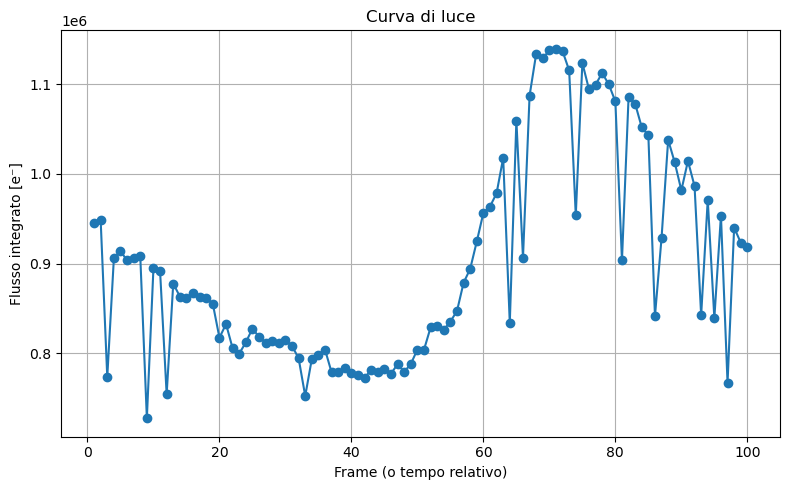

In [9]:
frames = frames[:100]
fluxes = fluxes[:100]

plot_light_curve(frames, fluxes)

Evidenziamo gli outlier nel grafico per essere sicuri di prendere quelli giusti

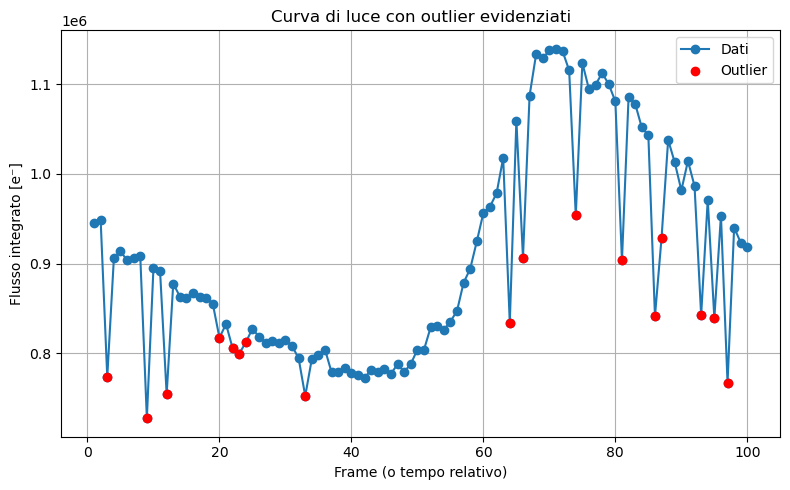

In [11]:
# Lista dei frame outlier
outlier_frames = [3, 9, 12, 20, 22, 23, 24, 33, 64, 66, 74, 81, 86, 87, 93, 95, 97]

# Trova gli indici corrispondenti agli outlier nella lista `frames`
outlier_indices = [i for i, f in enumerate(frames) if f in outlier_frames]

# Estrai i valori di flusso e frame corrispondenti agli outlier
outlier_fluxes = [fluxes[i] for i in outlier_indices]
outlier_x = [frames[i] for i in outlier_indices]

# Plotta la curva di luce con gli outlier evidenziati
plt.figure(figsize=(8, 5))
plt.plot(frames, fluxes, marker='o', linestyle='-', label='Dati')
plt.scatter(outlier_x, outlier_fluxes, color='red', label='Outlier', zorder=5)
plt.xlabel("Frame (o tempo relativo)")
plt.ylabel("Flusso integrato [e⁻]")
plt.title("Curva di luce con outlier evidenziati")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


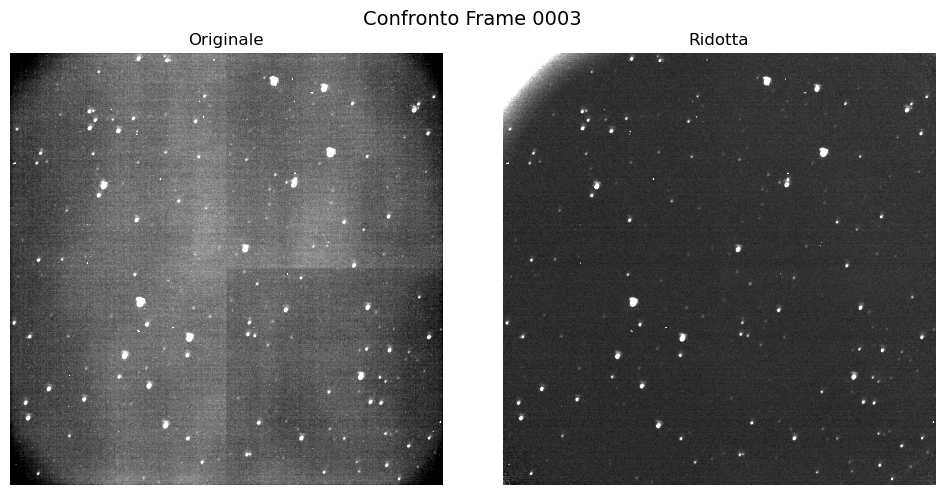

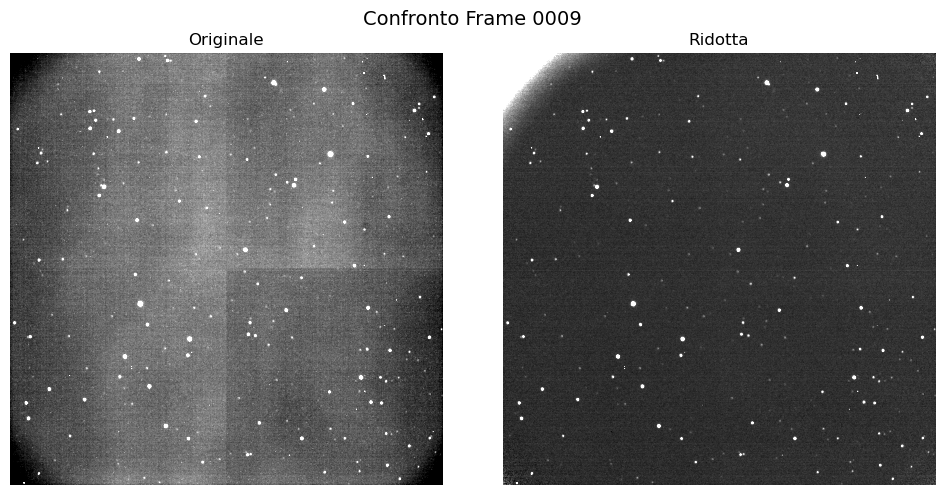

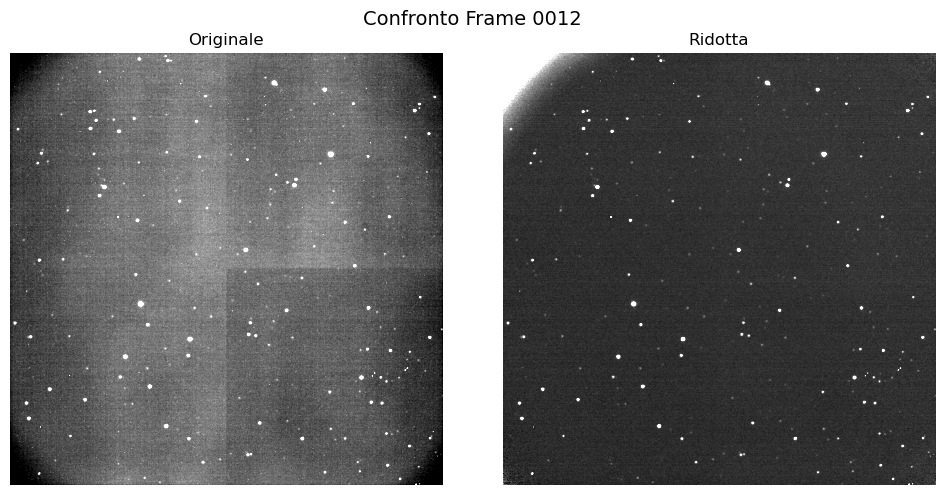

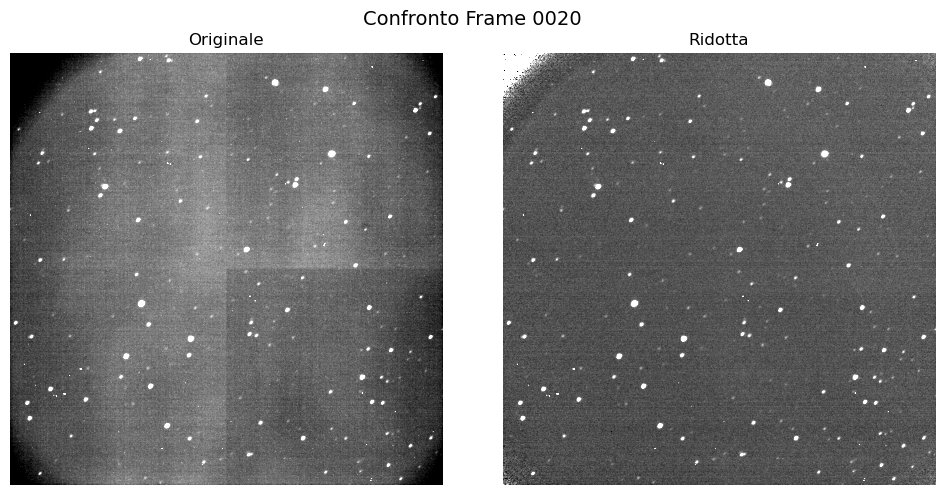

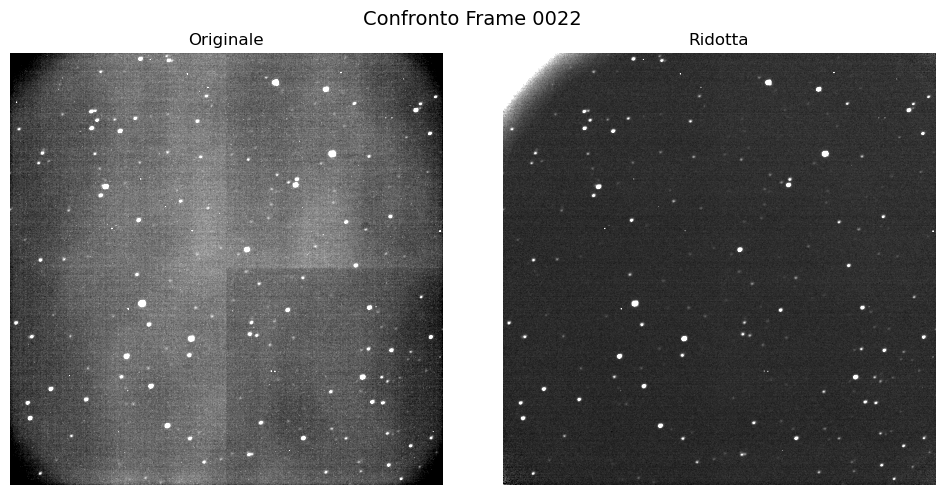

...

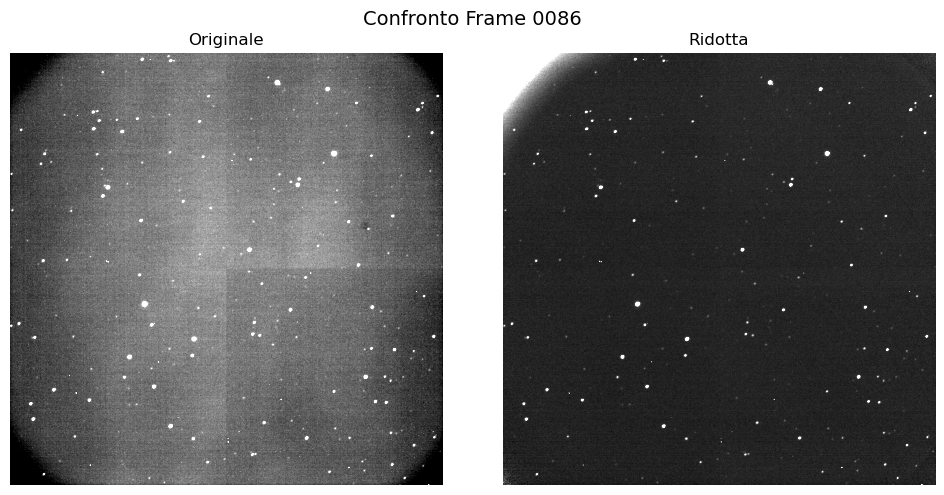

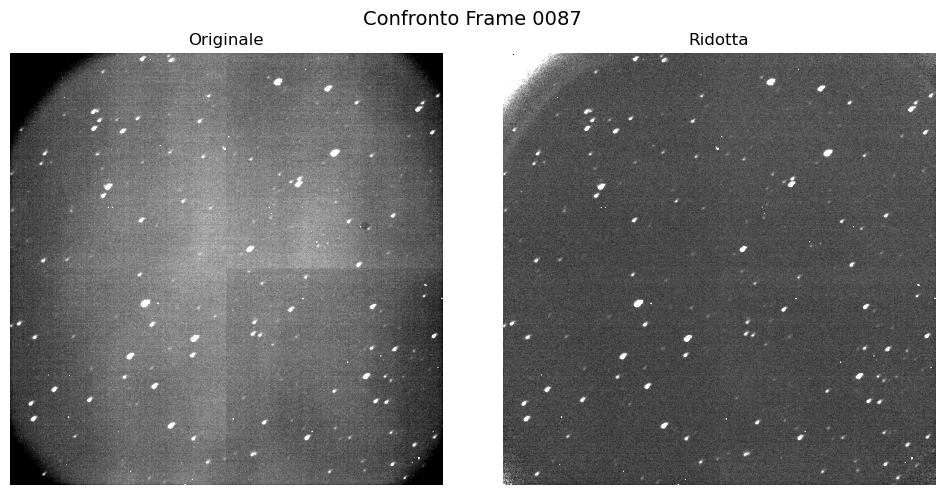

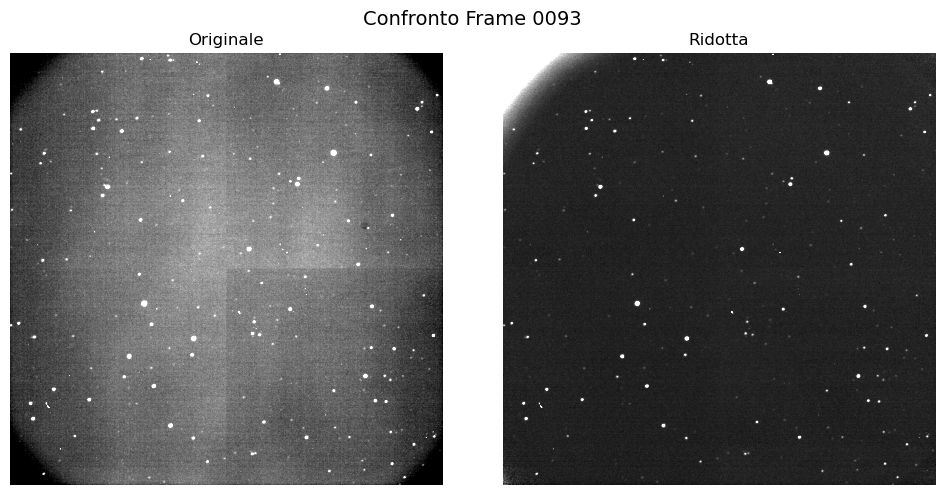

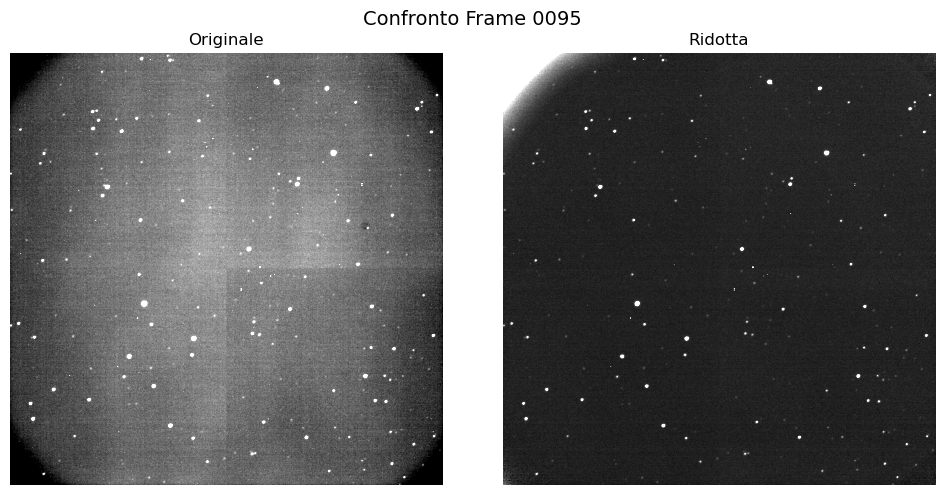

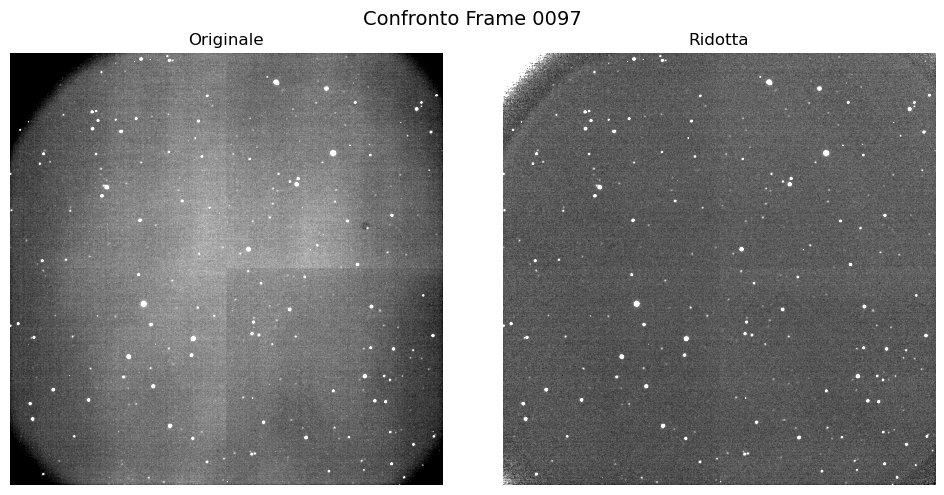

In [15]:
#VEDIAMO I FRAME CHE SONO OUTLIER

# Directory dei file originali e ridotti
original_dir = '/Users/claudiamurro/Desktop/laboratorio tecnologie astronomiche/cupani/sci'
reduced_dir = '/Users/claudiamurro/Desktop/laboratorio tecnologie astronomiche/cupani/reduced'

# Funzione per caricare un'immagine FITS data una directory e un nome file
def load_image(directory, filename):
    filepath = os.path.join(directory, filename)
    with fits.open(filepath) as hdul:
        return hdul[0].data

# Visualizza originali e ridotte per i frame outlier
for frame in outlier_frames:
    original_name = f'SZ_Lyn-{frame:04d}_R.fit'
    reduced_name = f'SZ_Lyn-{frame:04d}_reduced.fit'

    try:
        original = load_image(original_dir, original_name)
        reduced = load_image(reduced_dir, reduced_name)

        # Plot affiancato
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        fig.suptitle(f'Confronto Frame {frame:04d}', fontsize=14)

        axes[0].imshow(original, cmap='gray', origin='lower', vmin=np.percentile(original, 5), vmax=np.percentile(original, 99))
        axes[0].set_title('Originale')
        axes[0].axis('off')

        axes[1].imshow(reduced, cmap='gray', origin='lower', vmin=np.percentile(reduced, 5), vmax=np.percentile(reduced, 99))
        axes[1].set_title('Ridotta')
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

    except FileNotFoundError as e:
        print(f"File mancante: {e}")

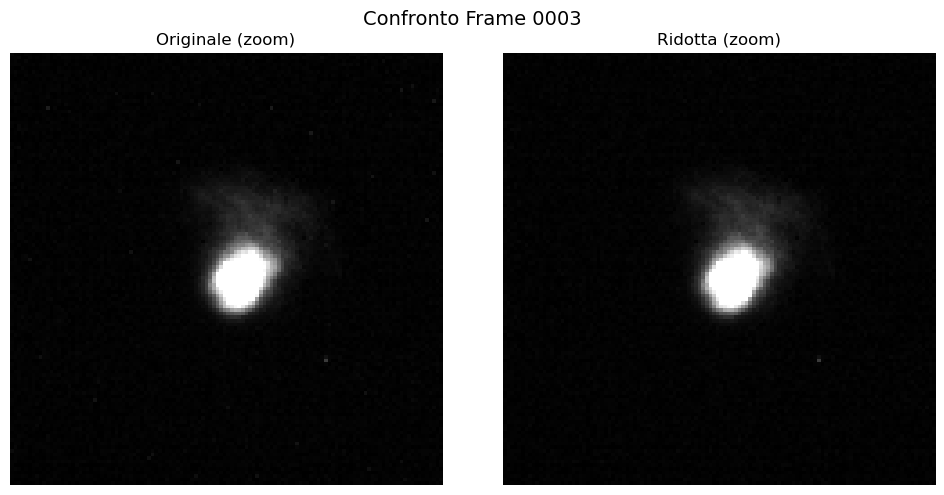

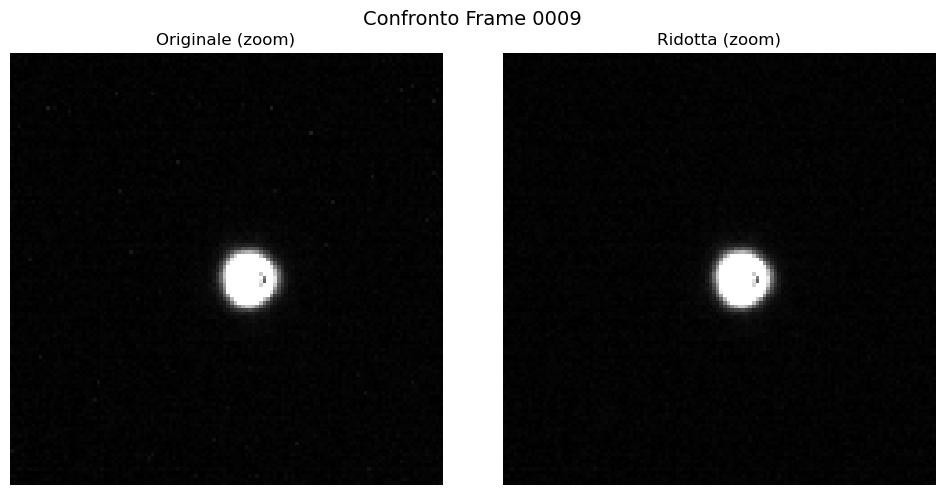

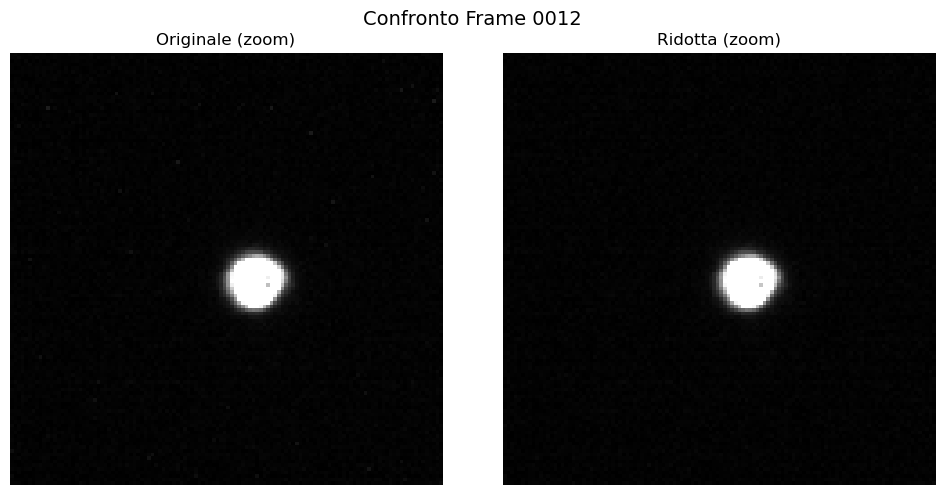

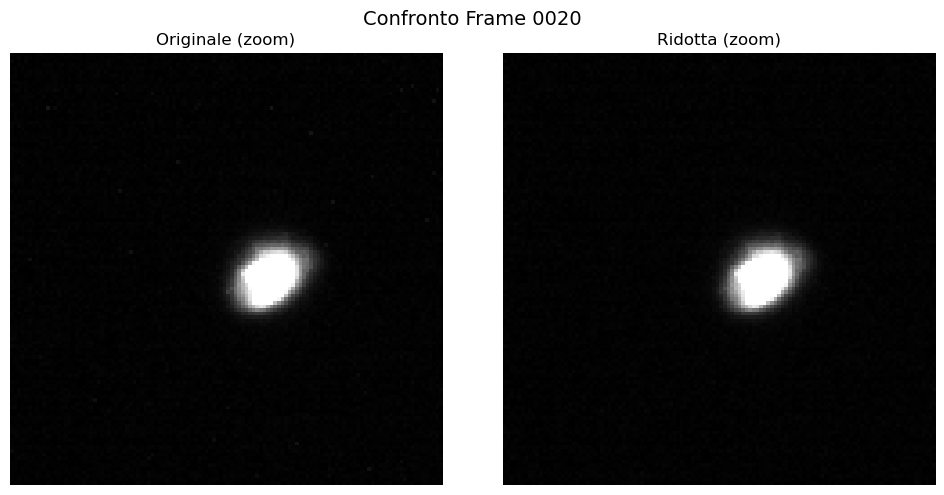

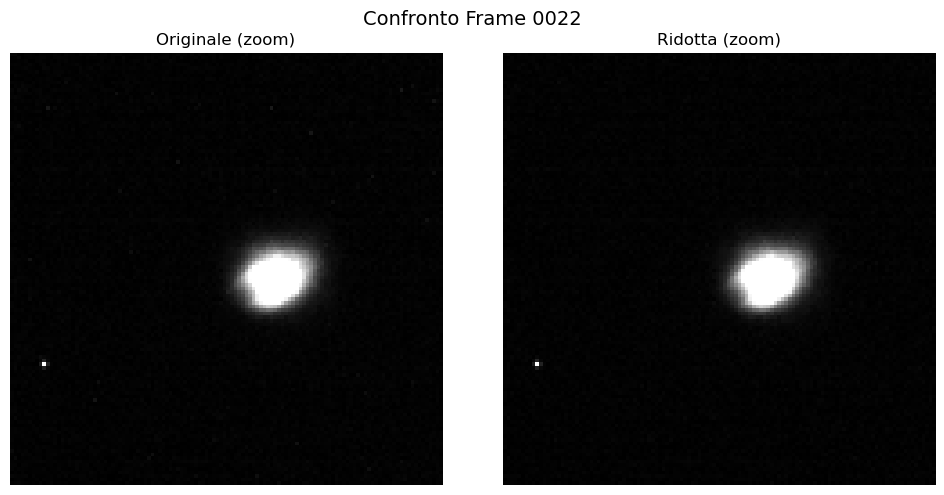

...

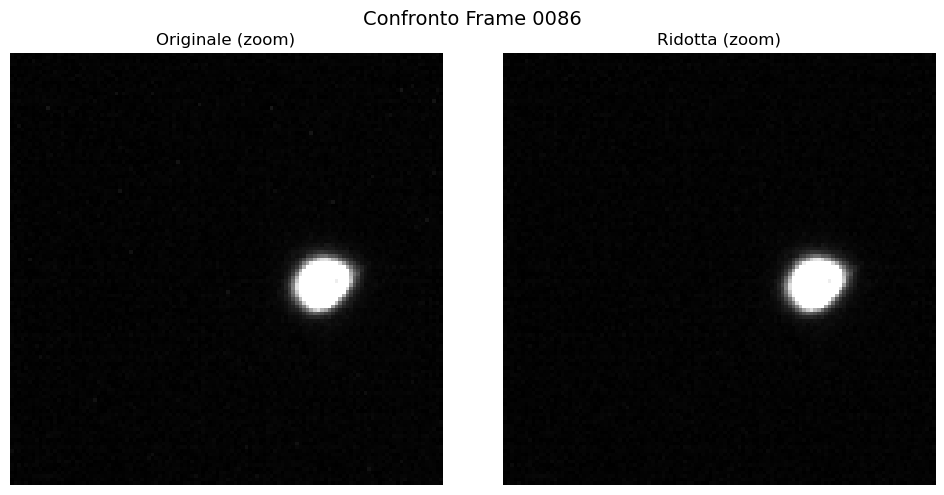

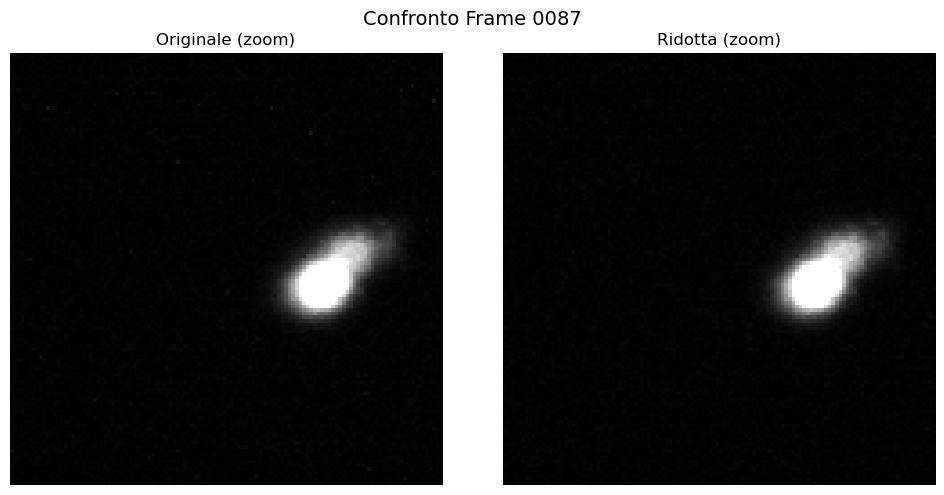

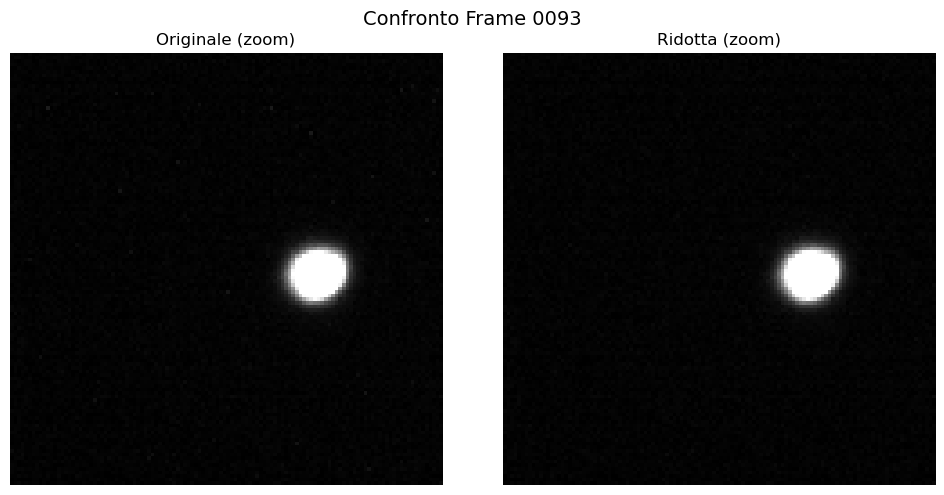

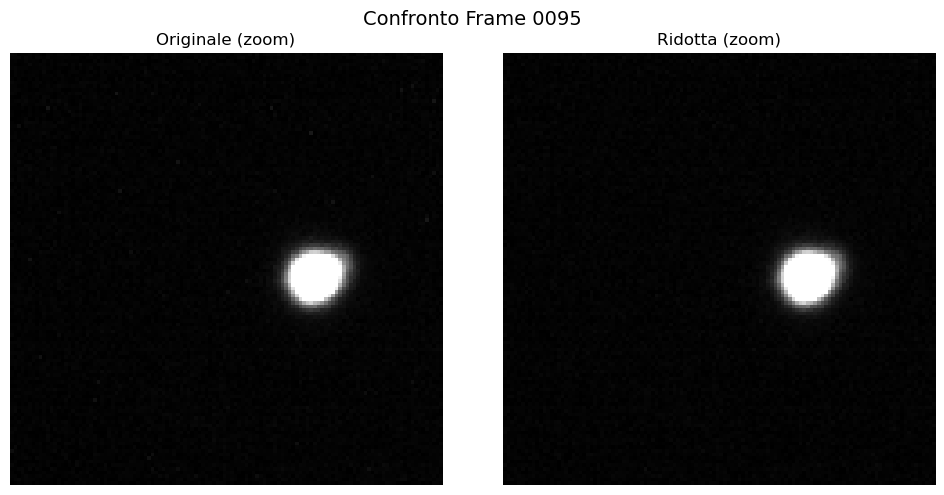

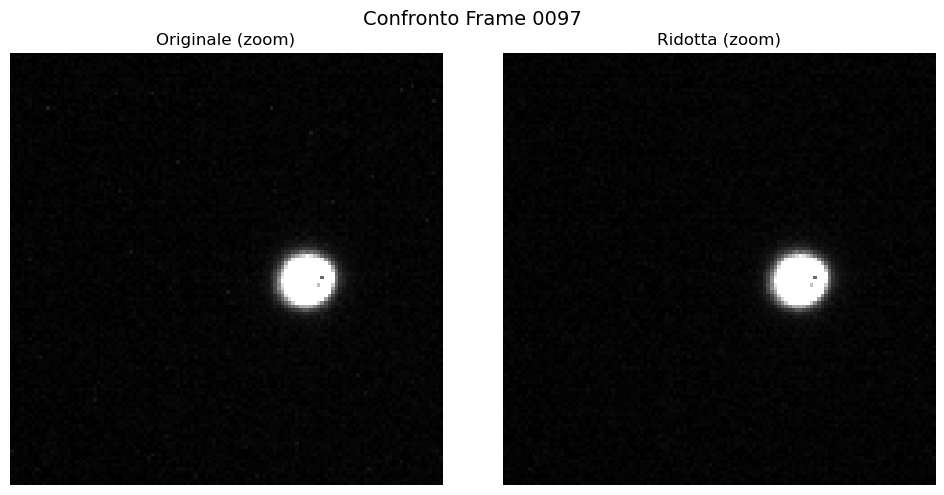

In [16]:
#ZOOM NEI FRAME OUTLIER

# Intervallo di taglio per zoom sulla regione del target
x_range = (550, 670)
y_range = (800, 920)

# Funzione per estrarre la sottoimmagine
def extract_subimage(image, x_range, y_range):
    return image[y_range[0]:y_range[1], x_range[0]:x_range[1]]

# Visualizza sottoimmagini originali e ridotte per i frame outlier
for frame in outlier_frames:
    original_name = f'SZ_Lyn-{frame:04d}_R.fit'
    reduced_name = f'SZ_Lyn-{frame:04d}_reduced.fit'

    try:
        original = extract_subimage(load_image(original_dir, original_name), x_range, y_range)
        reduced = extract_subimage(load_image(reduced_dir, reduced_name), x_range, y_range)

        # Plot affiancato delle sottoimmagini
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        fig.suptitle(f'Confronto Frame {frame:04d}', fontsize=14)

        axes[0].imshow(original, cmap='gray', origin='lower', 
                       vmin=np.percentile(original, 5), vmax=np.percentile(original, 99))
        axes[0].set_title('Originale (zoom)')
        axes[0].axis('off')

        axes[1].imshow(reduced, cmap='gray', origin='lower', 
                       vmin=np.percentile(reduced, 5), vmax=np.percentile(reduced, 99))
        axes[1].set_title('Ridotta (zoom)')
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

    except FileNotFoundError as e:
        print(f"File mancante: {e}")

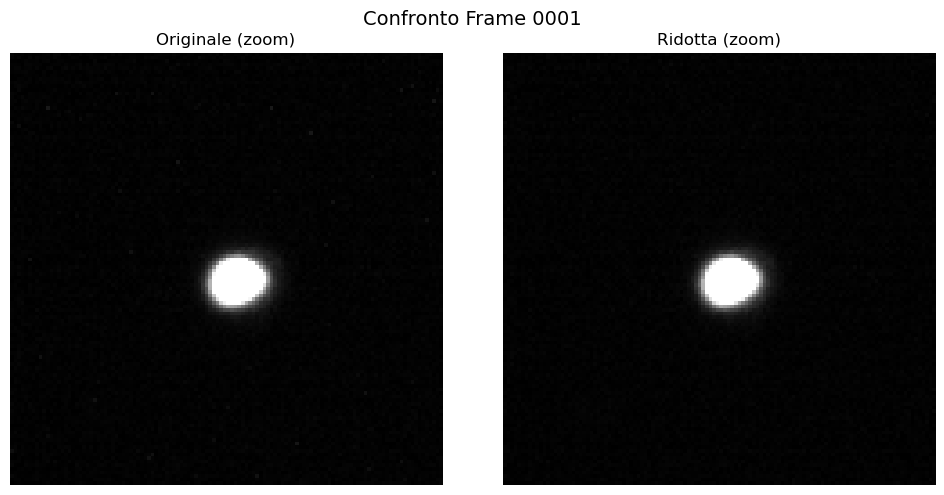

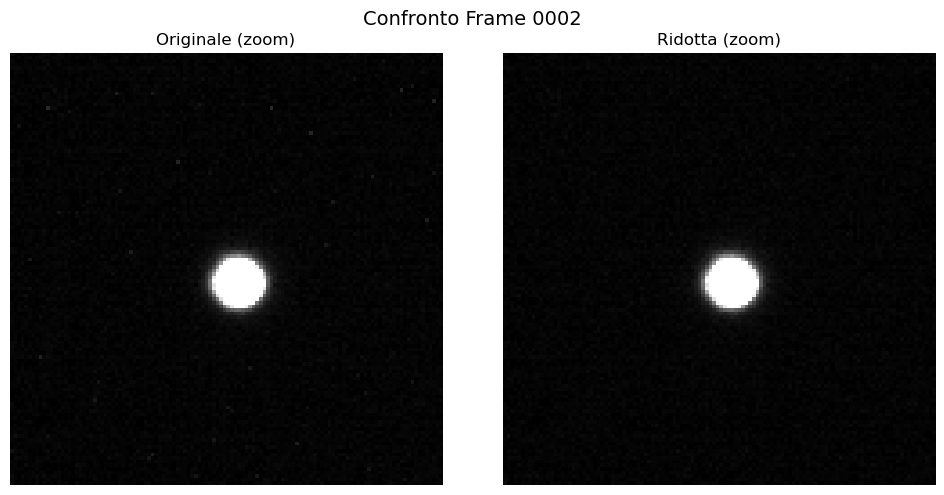

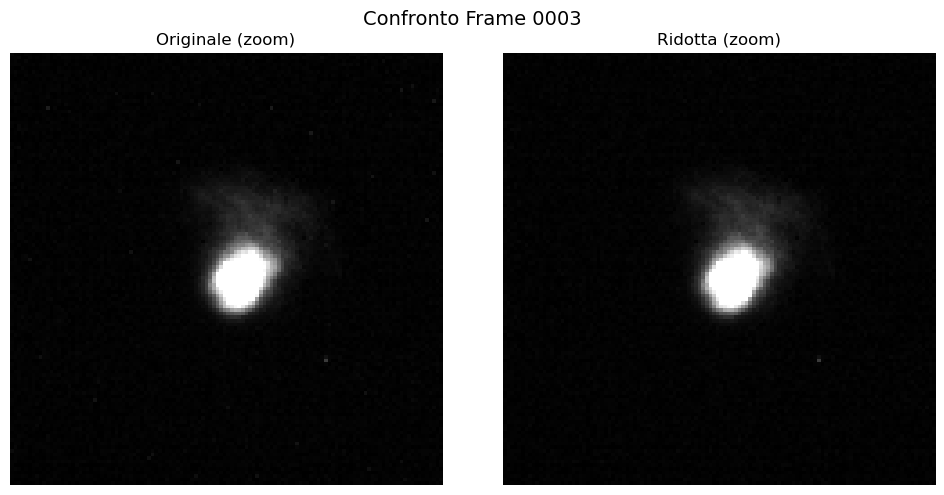

Frame 0003 è un outlier!


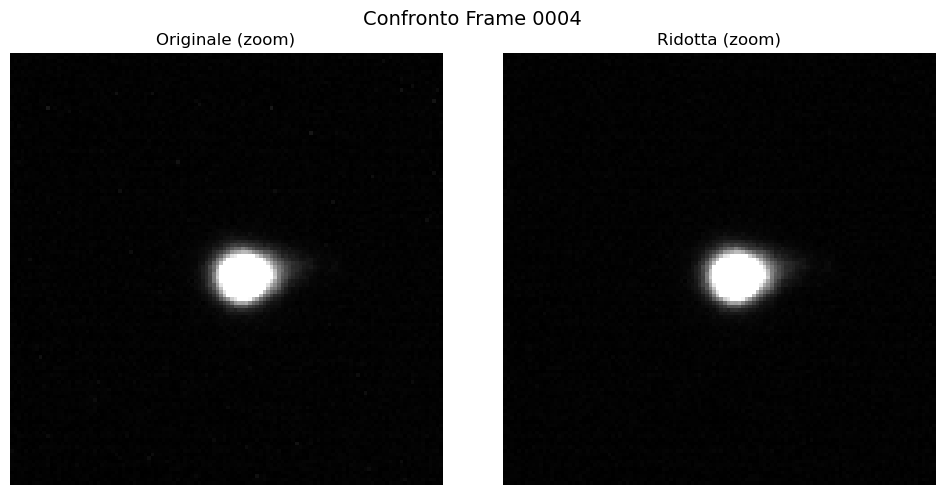

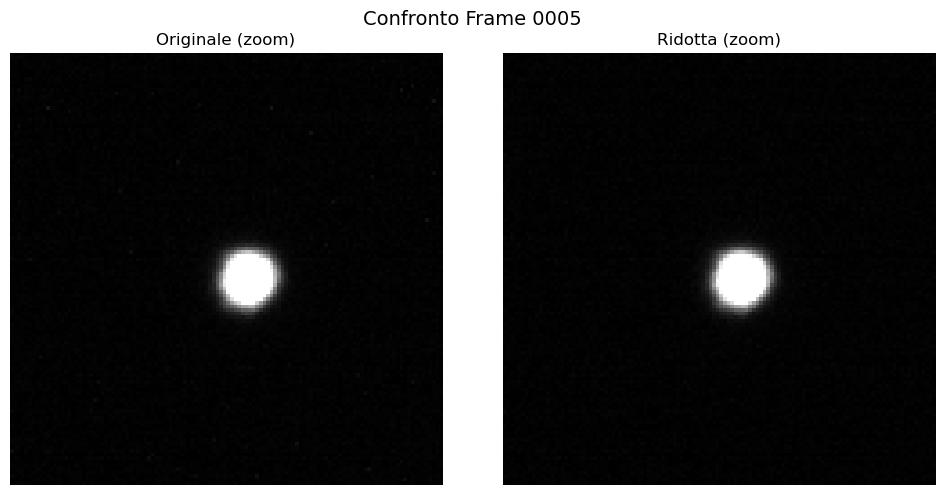

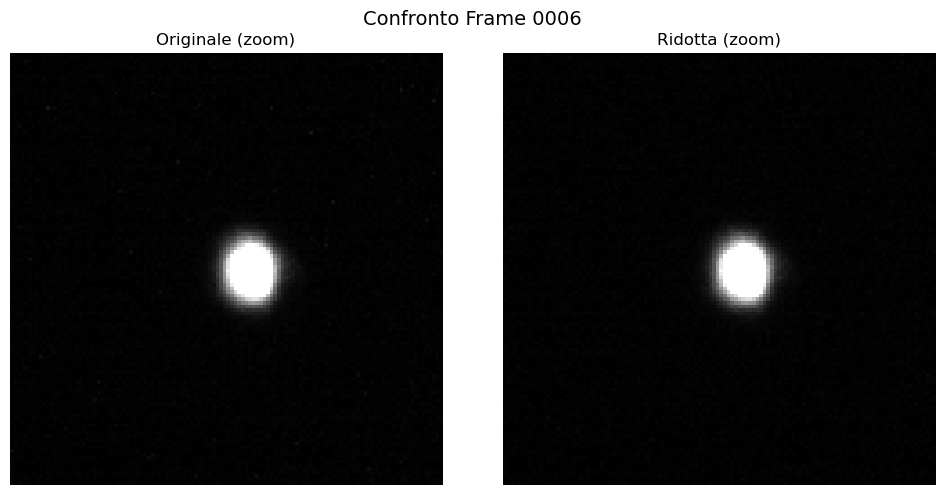

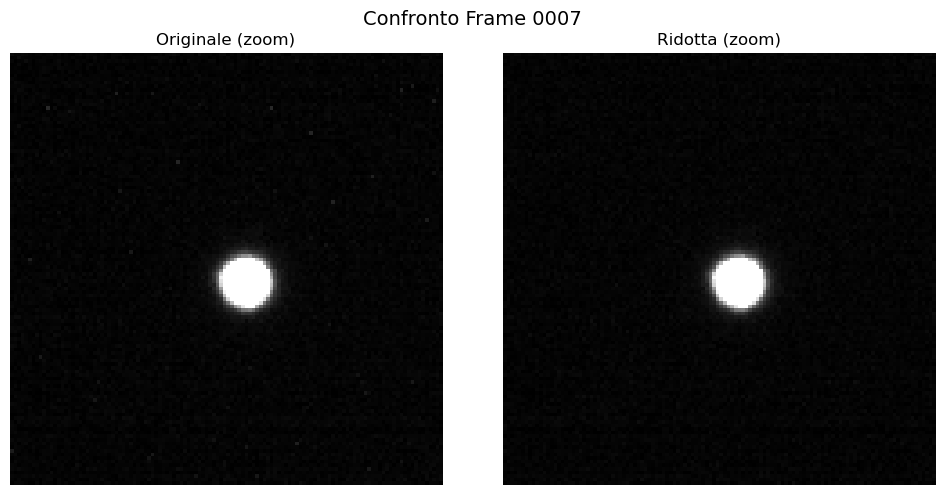

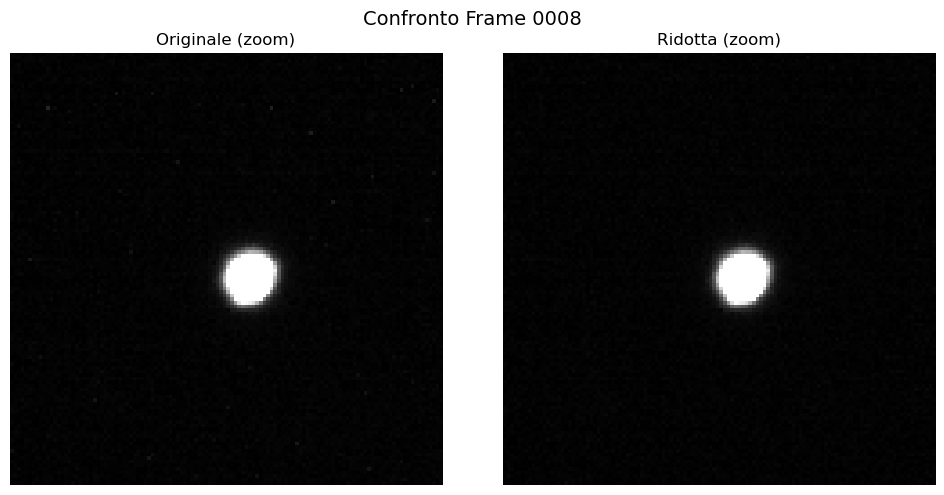

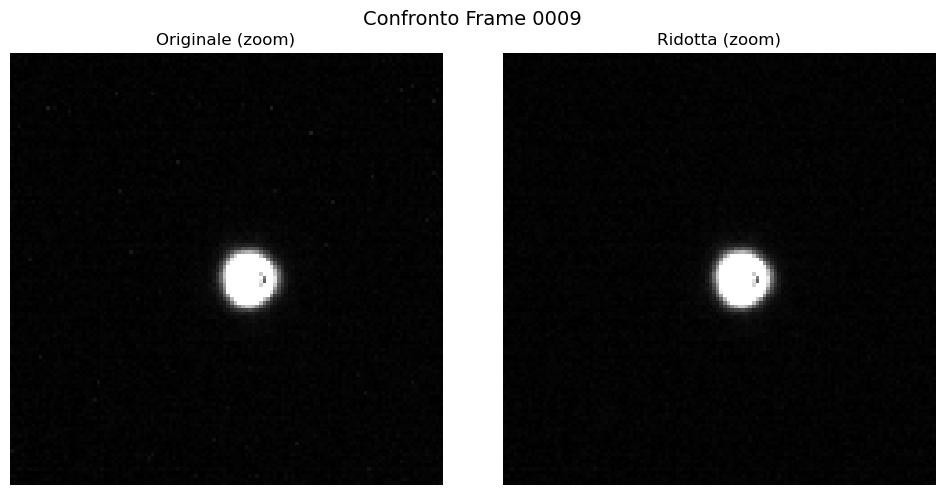

Frame 0009 è un outlier!


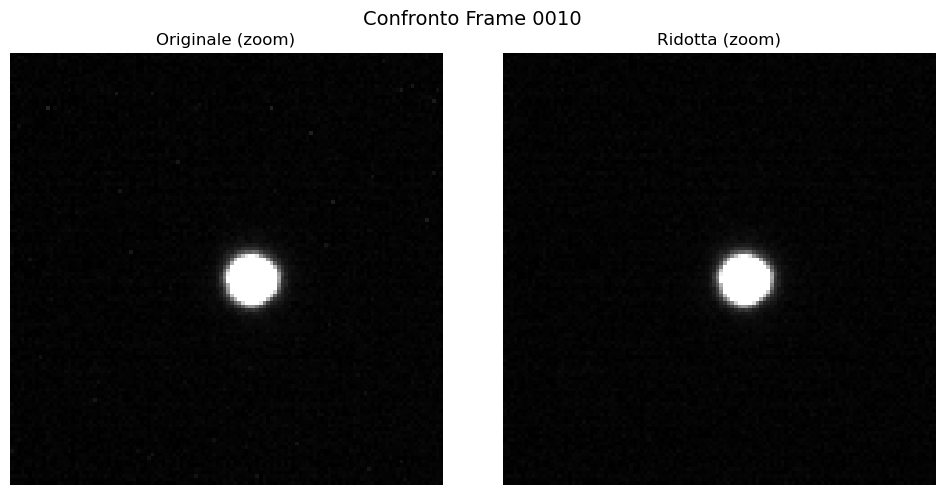

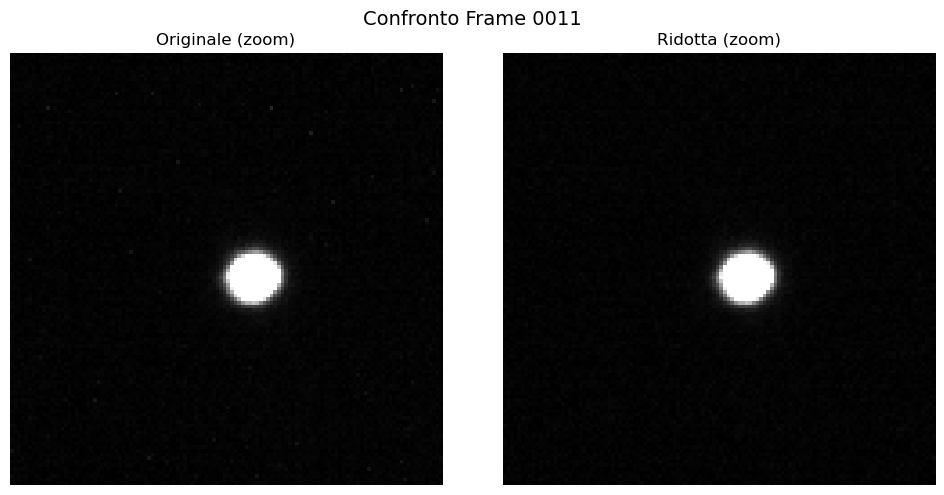

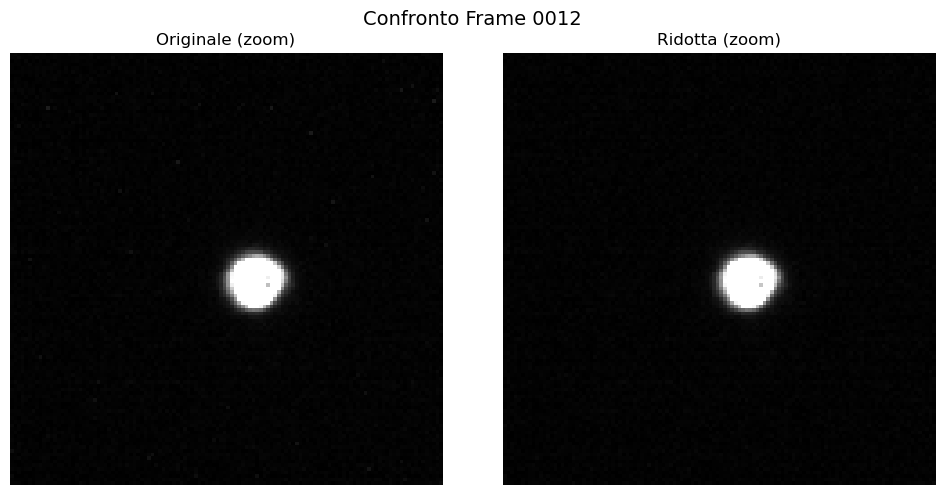

Frame 0012 è un outlier!


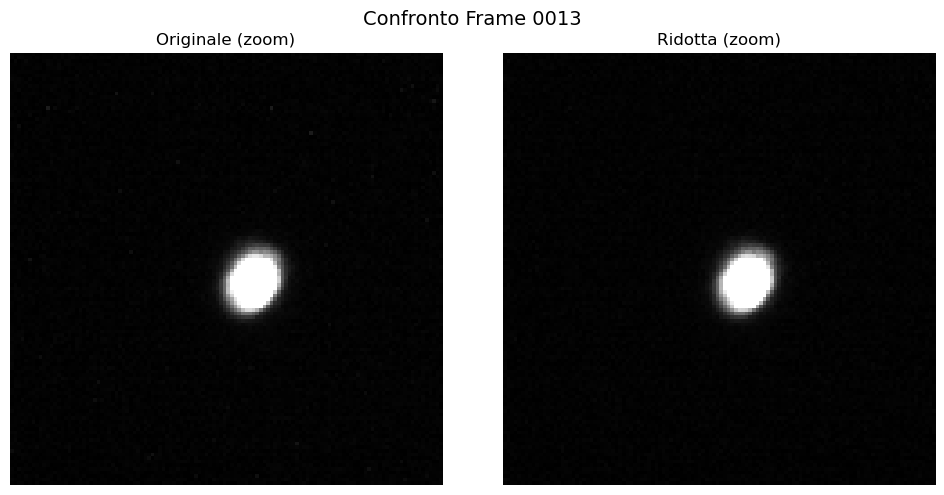

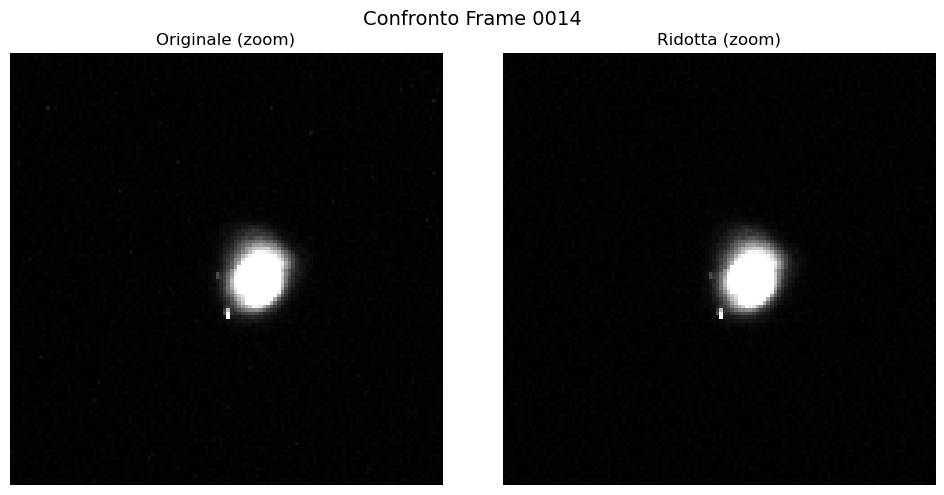

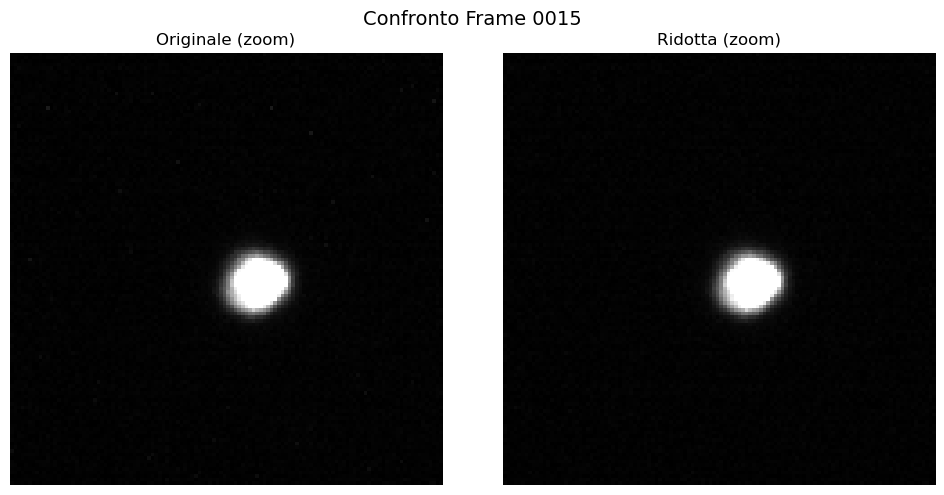

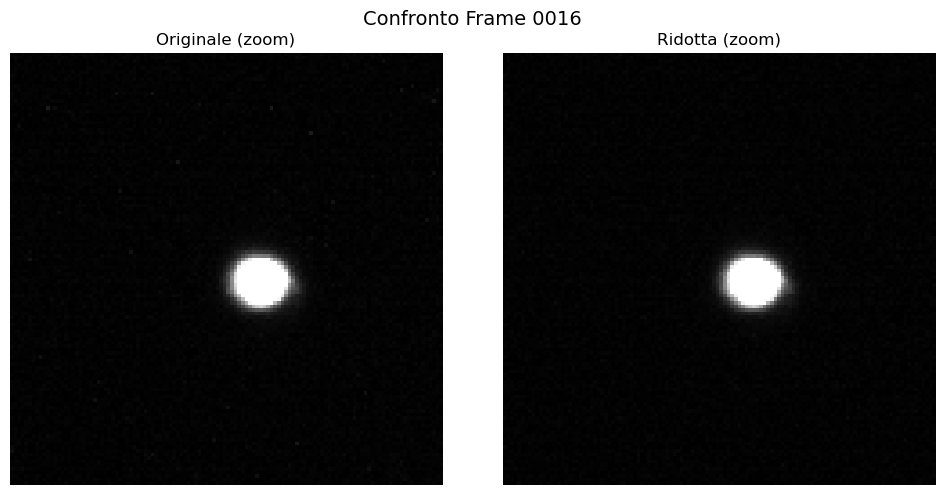

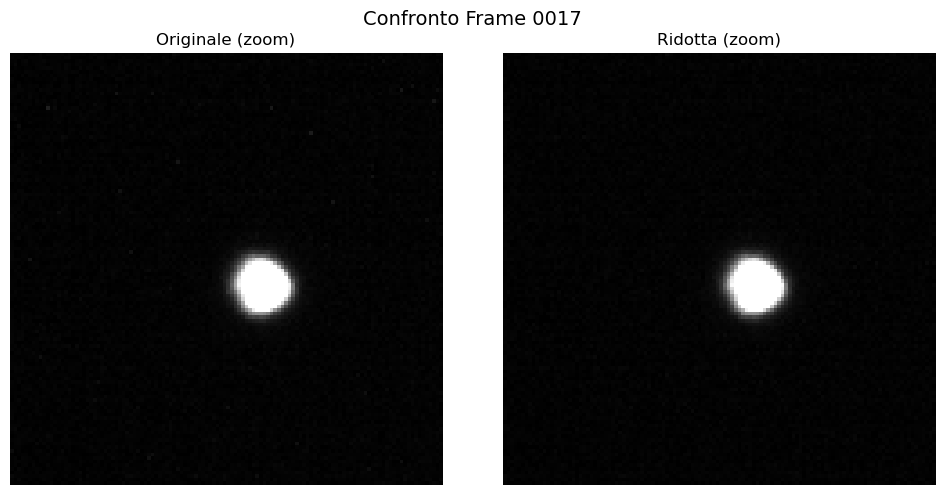

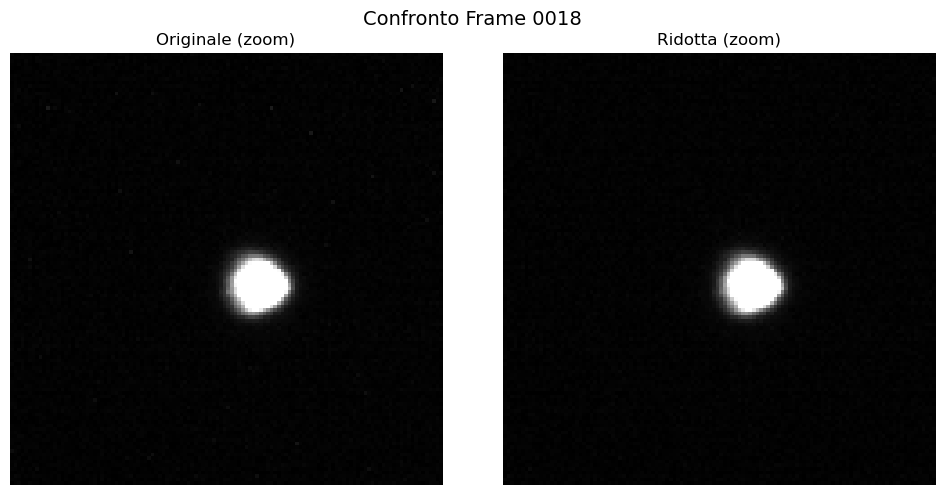

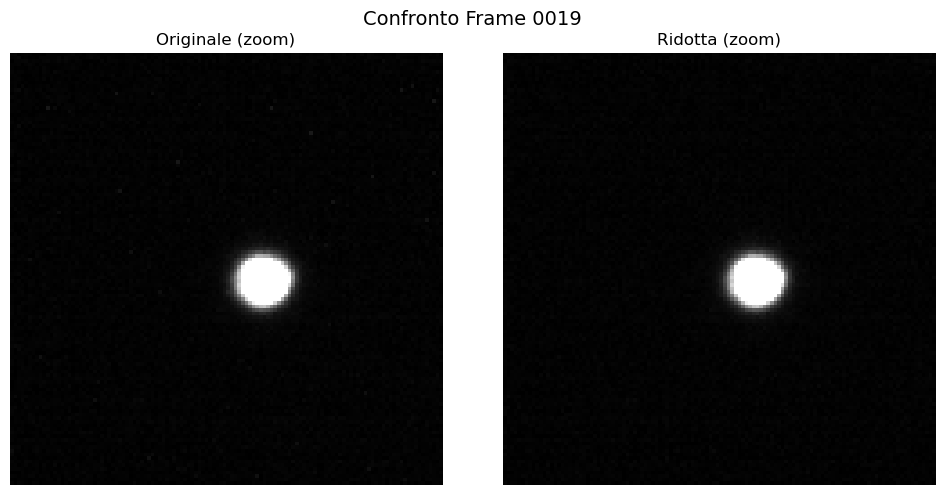

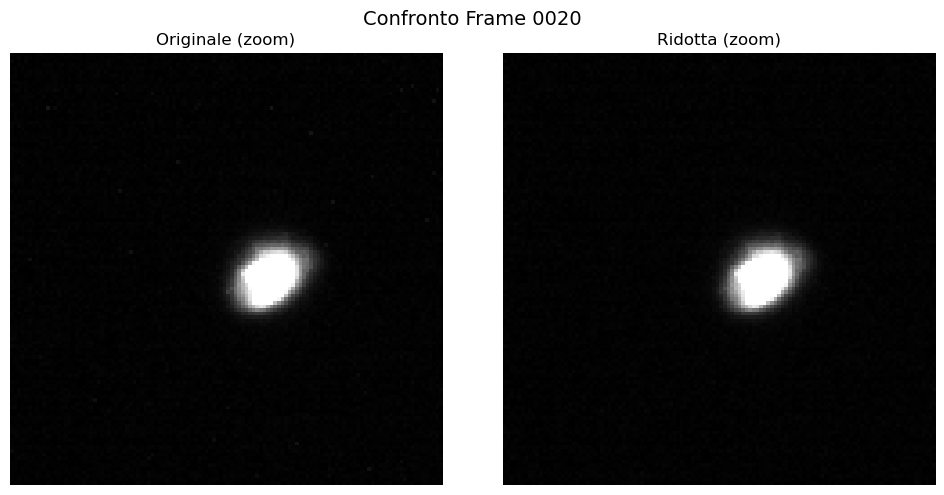

Frame 0020 è un outlier!


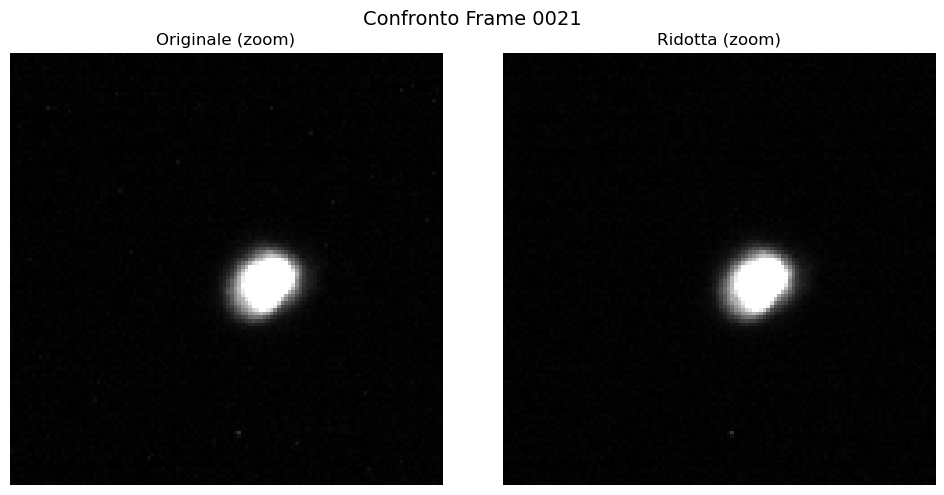

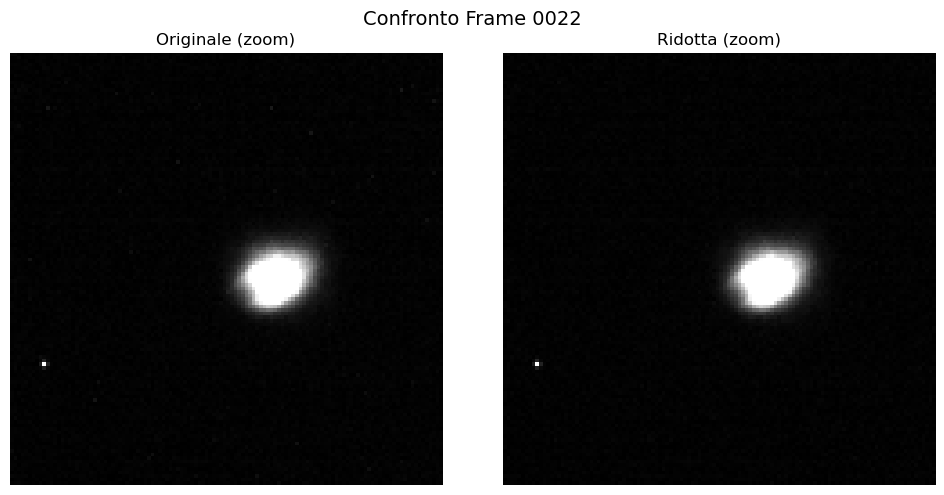

Frame 0022 è un outlier!


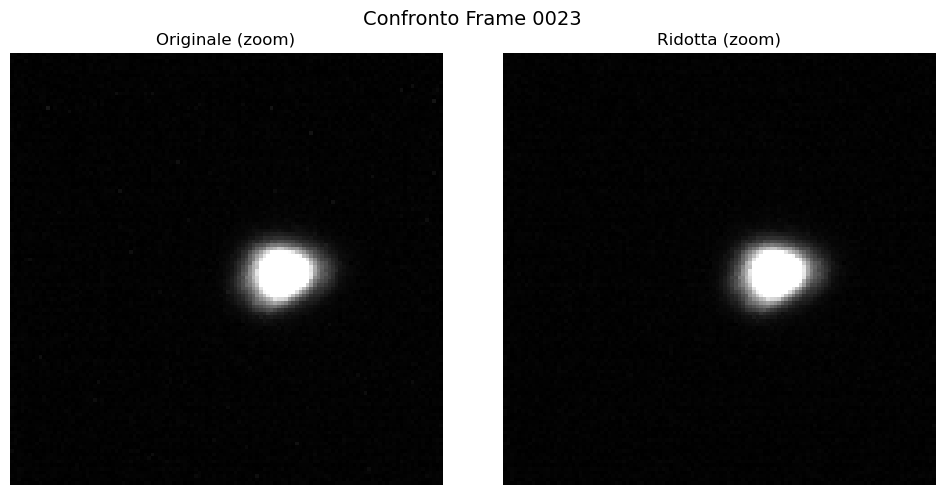

Frame 0023 è un outlier!


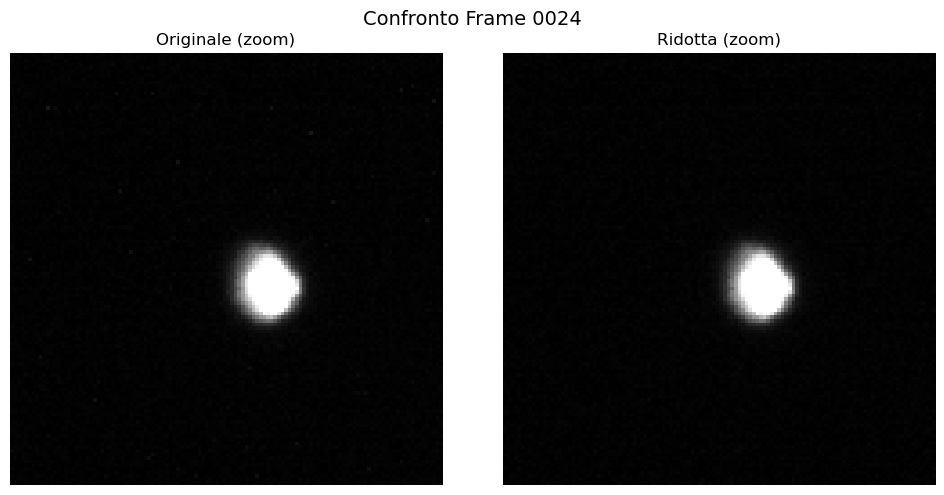

Frame 0024 è un outlier!


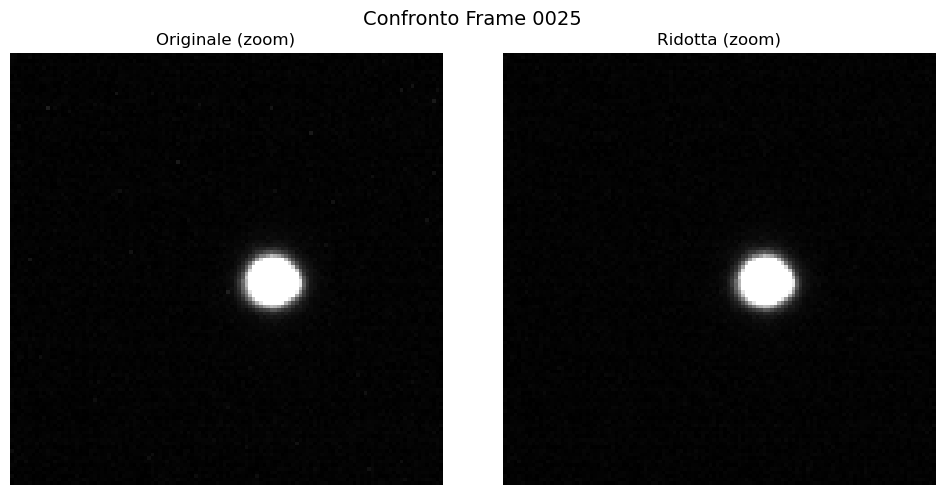

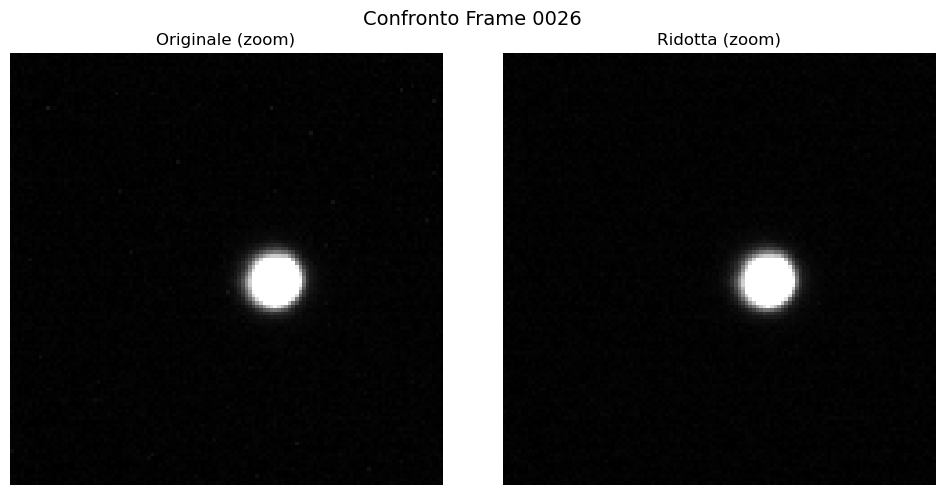

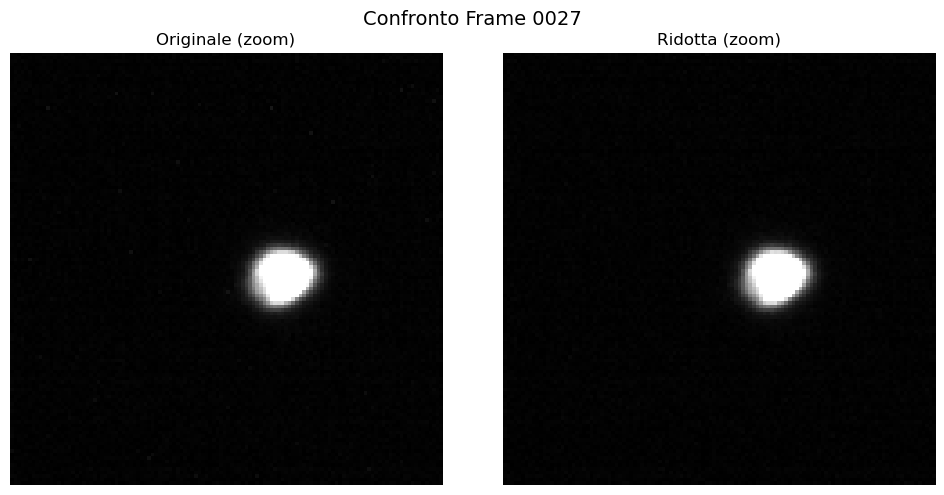

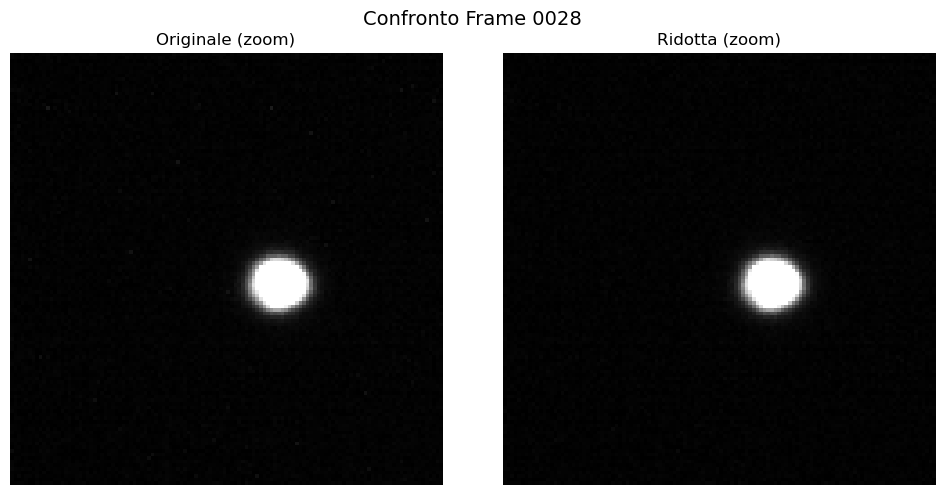

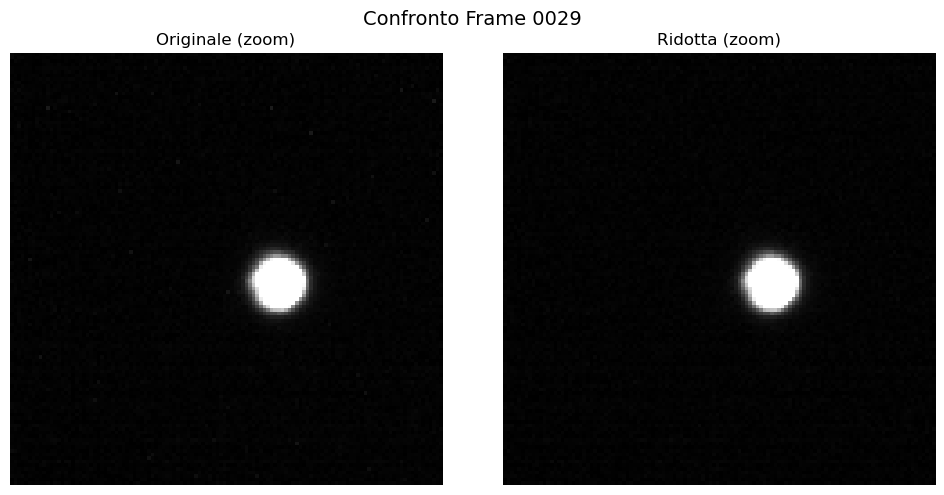

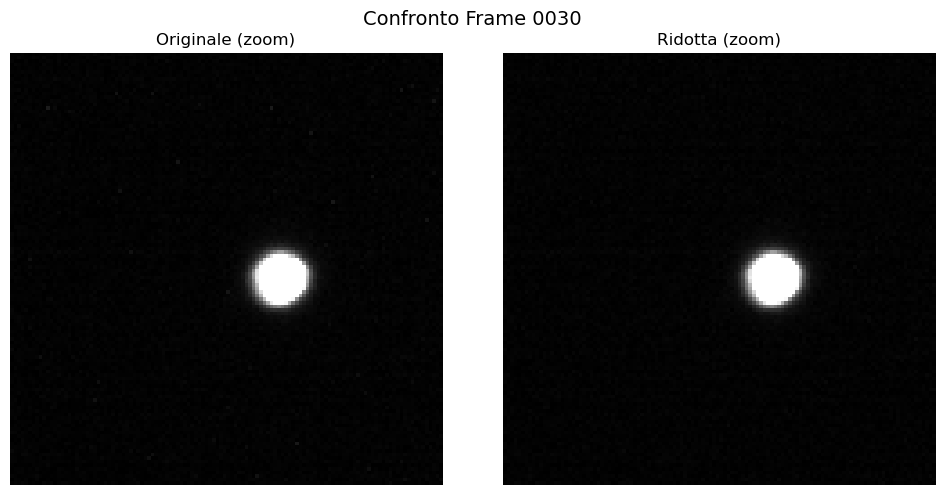

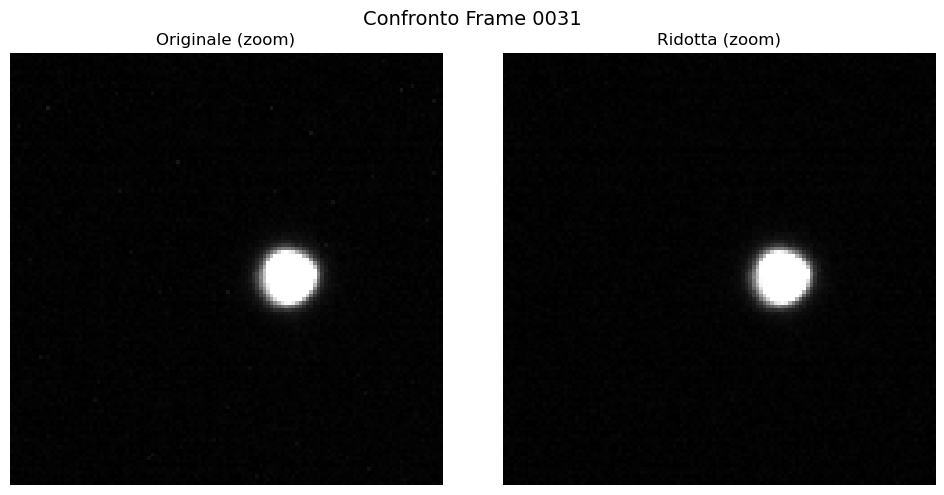

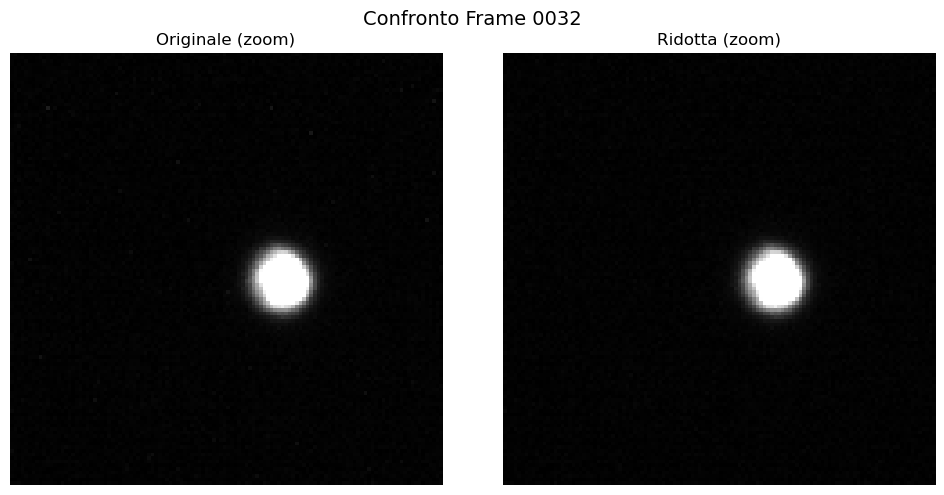

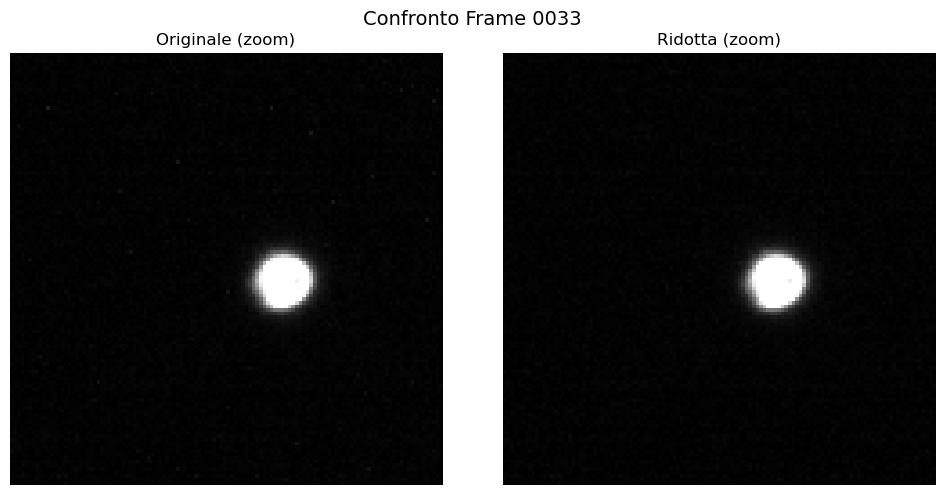

Frame 0033 è un outlier!


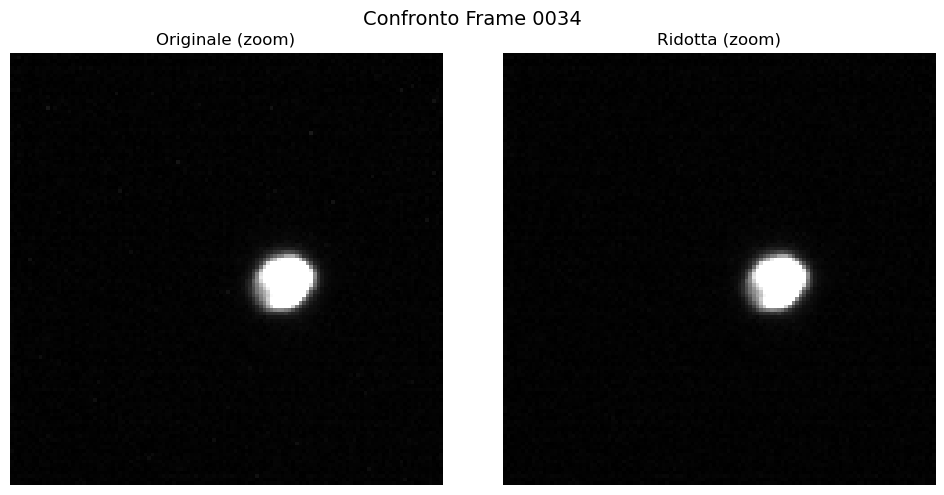

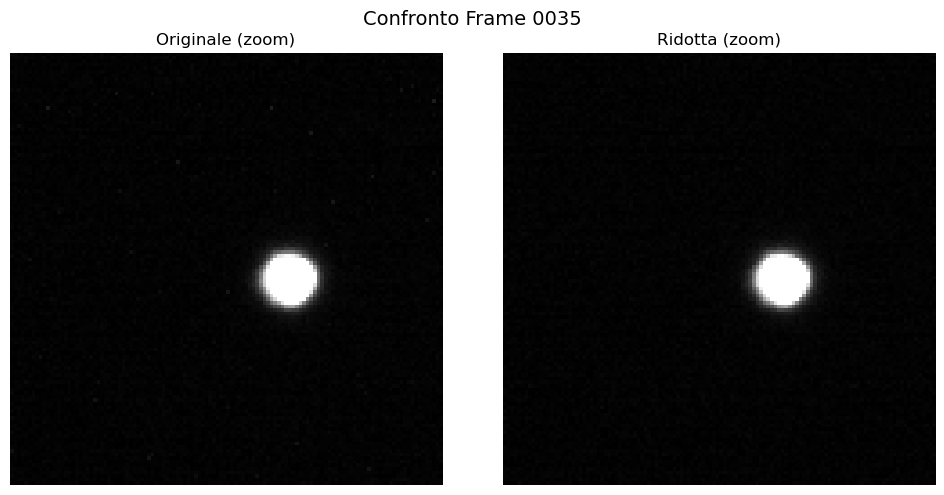

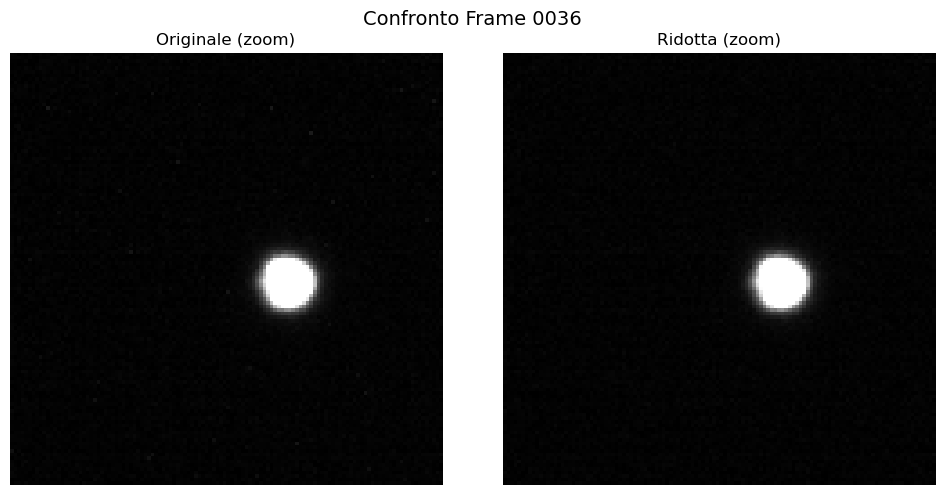

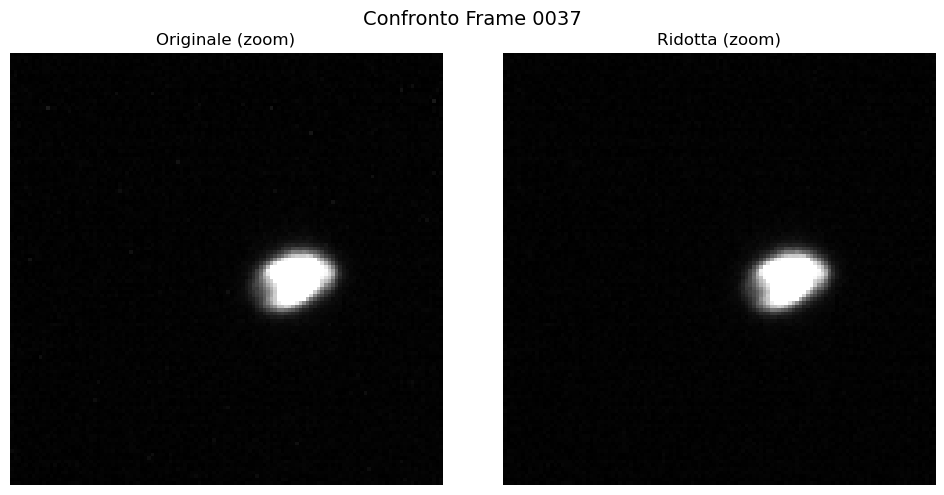

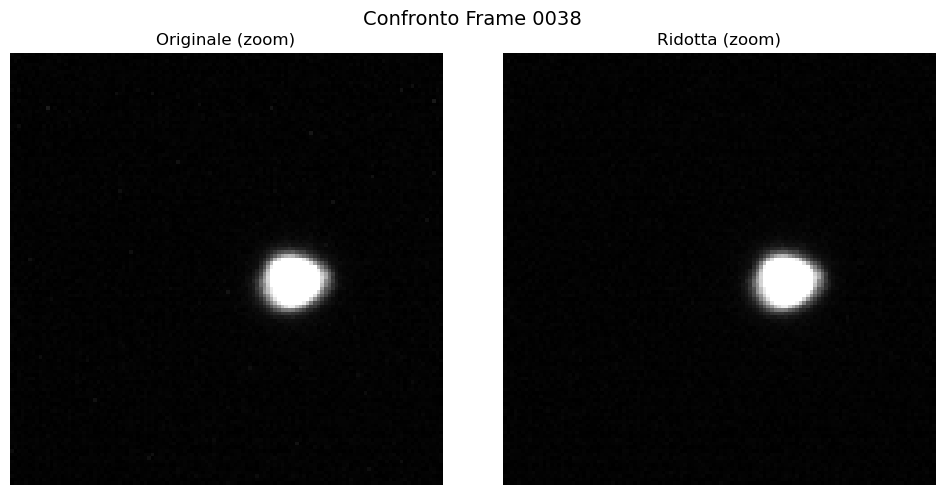

...

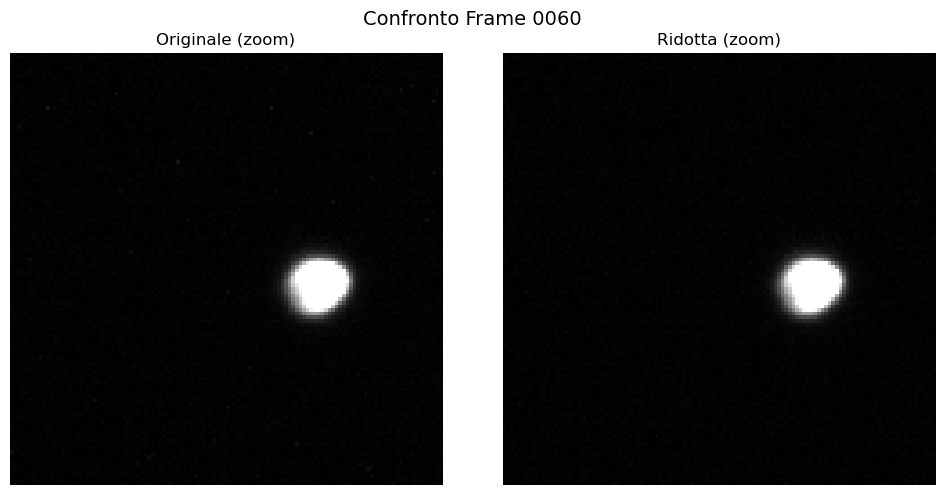

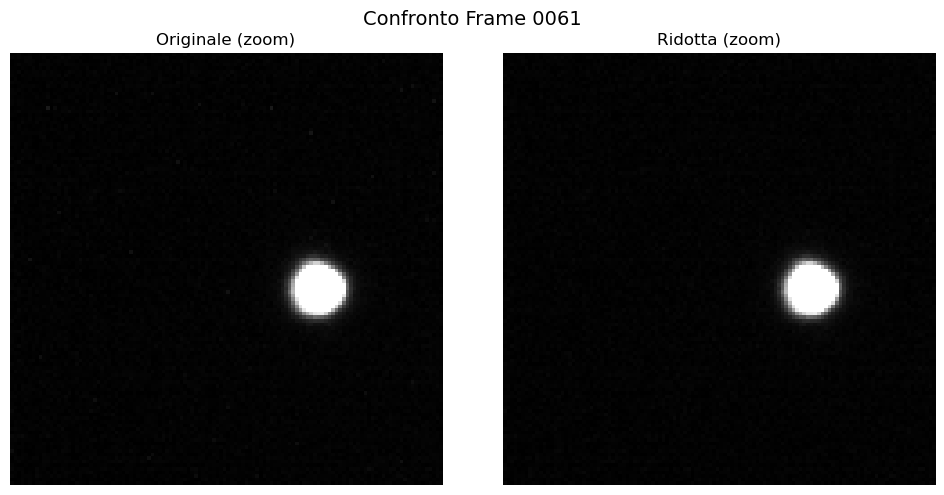

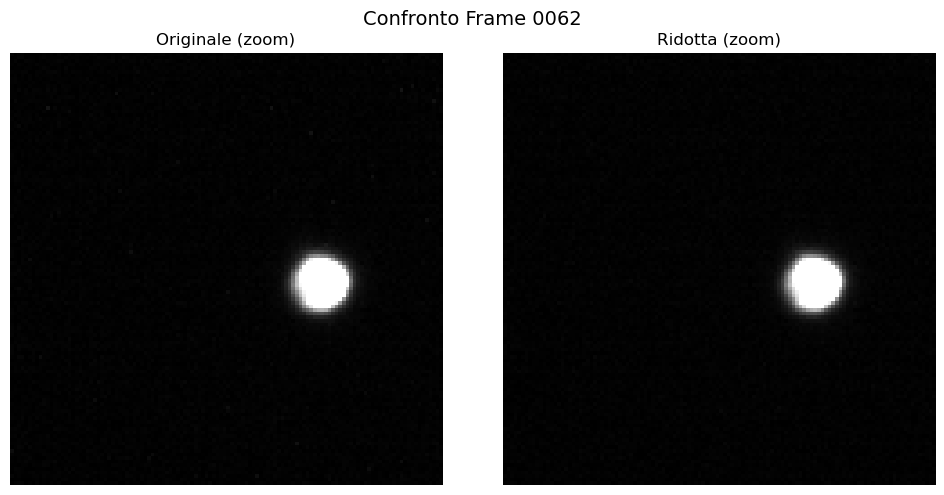

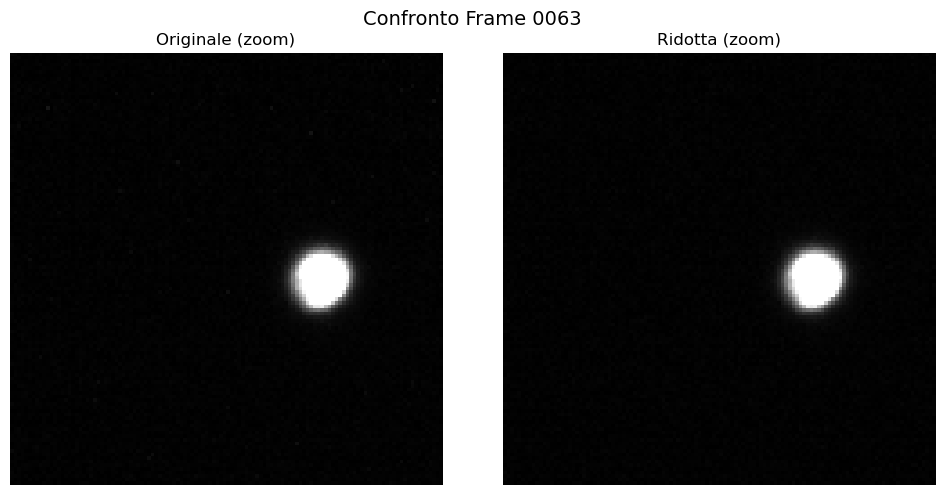

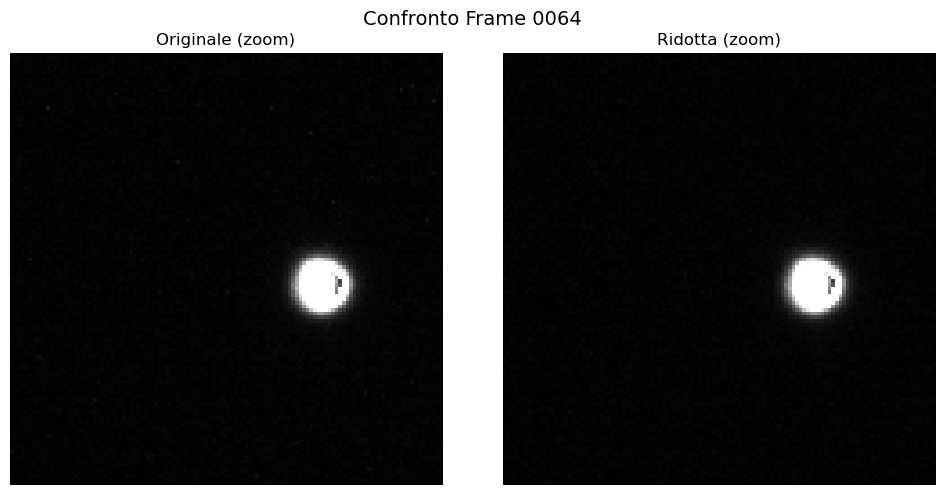

Frame 0064 è un outlier!


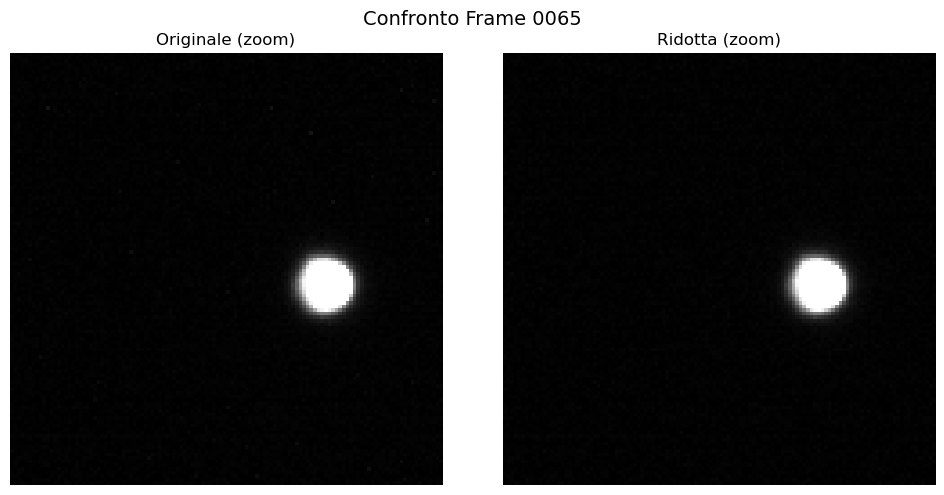

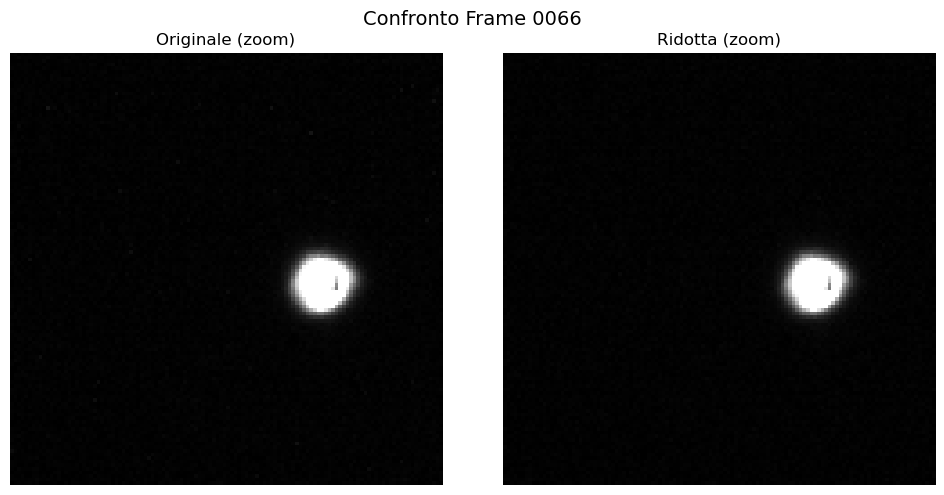

Frame 0066 è un outlier!


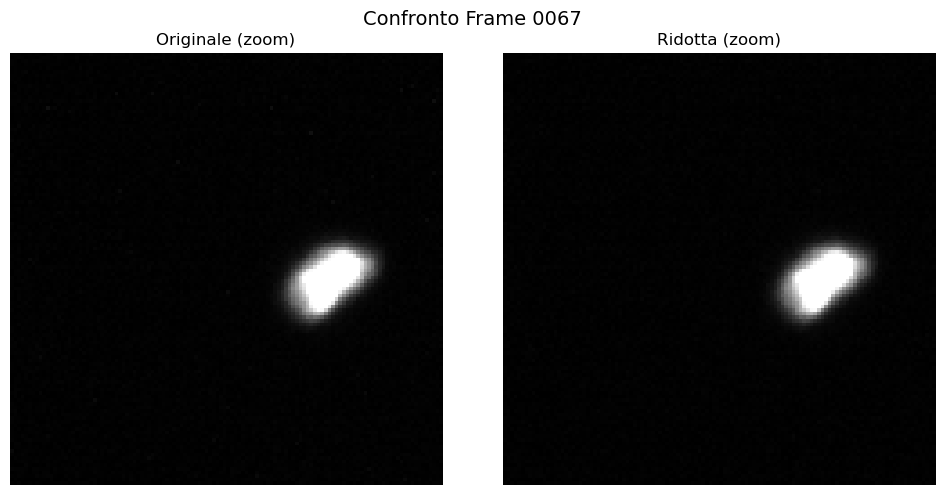

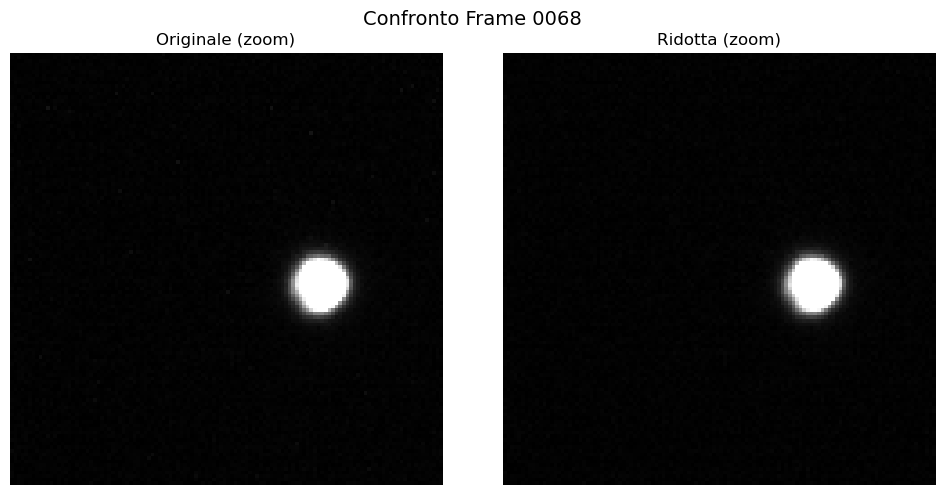

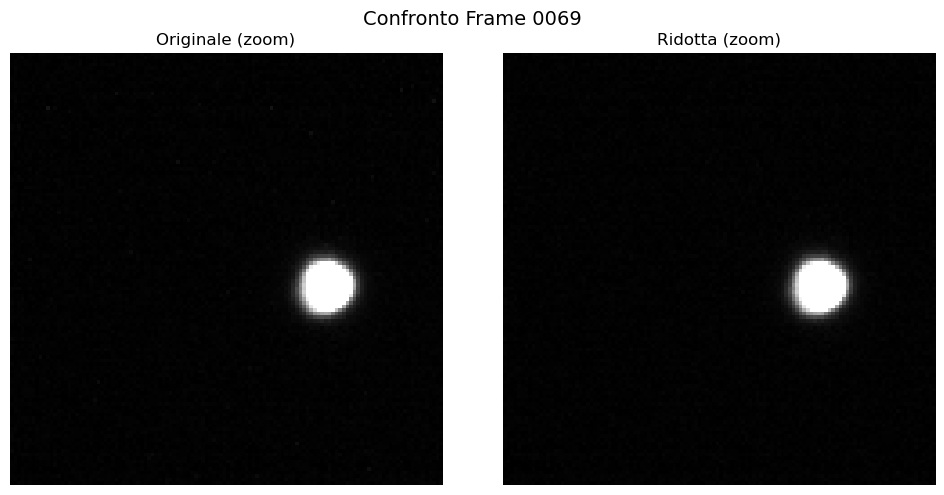

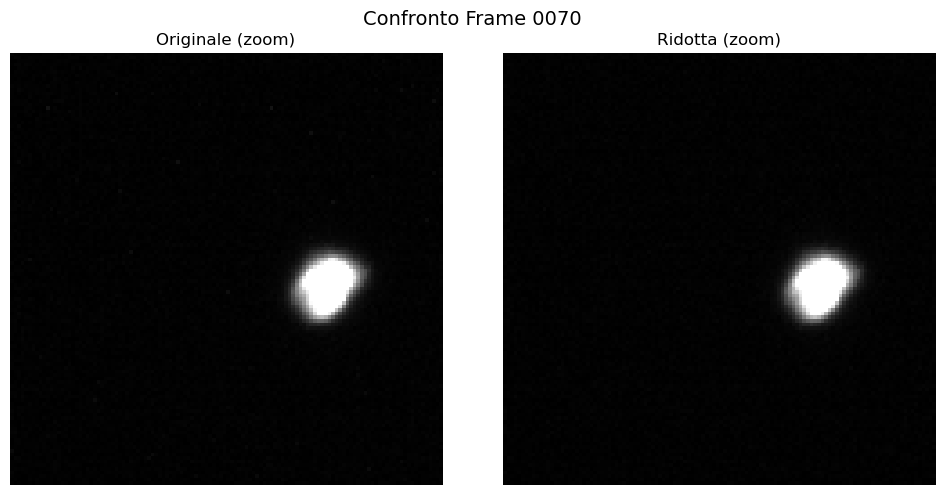

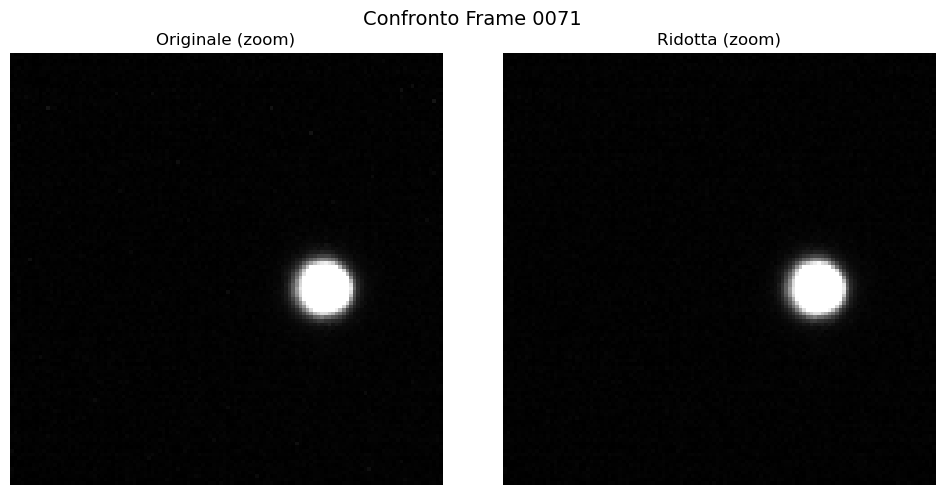

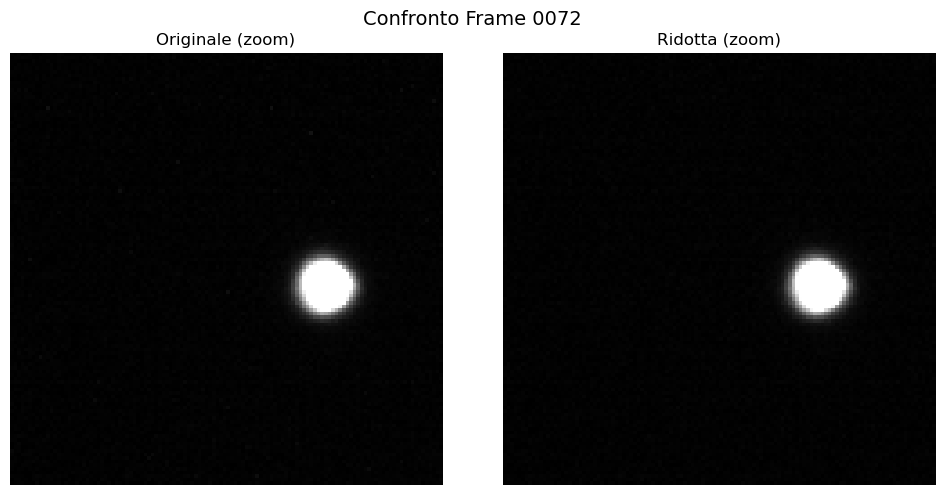

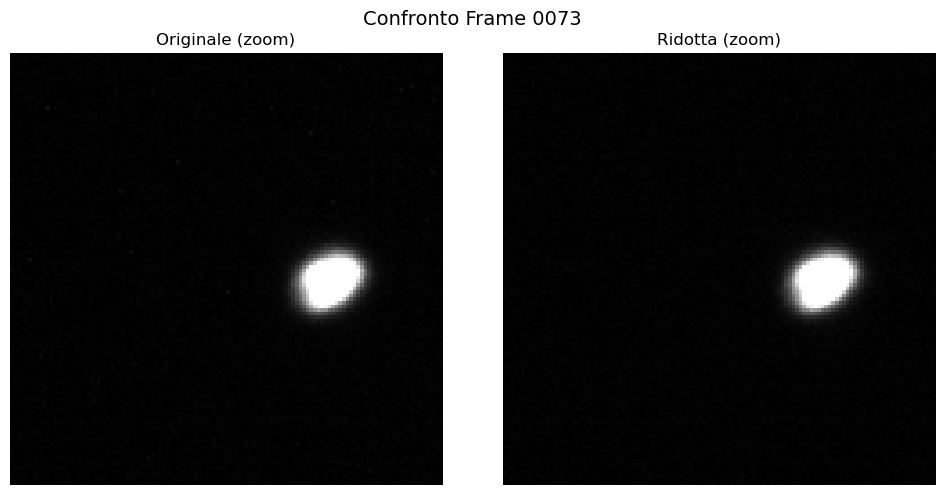

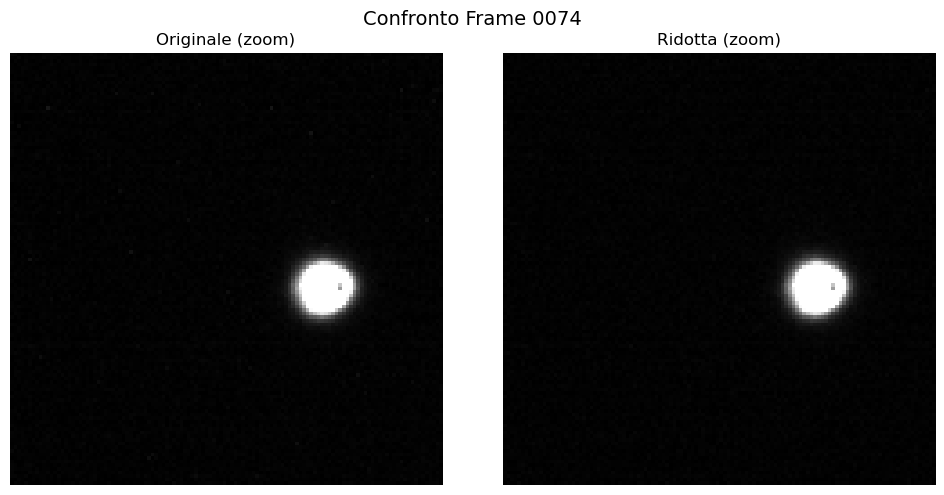

Frame 0074 è un outlier!


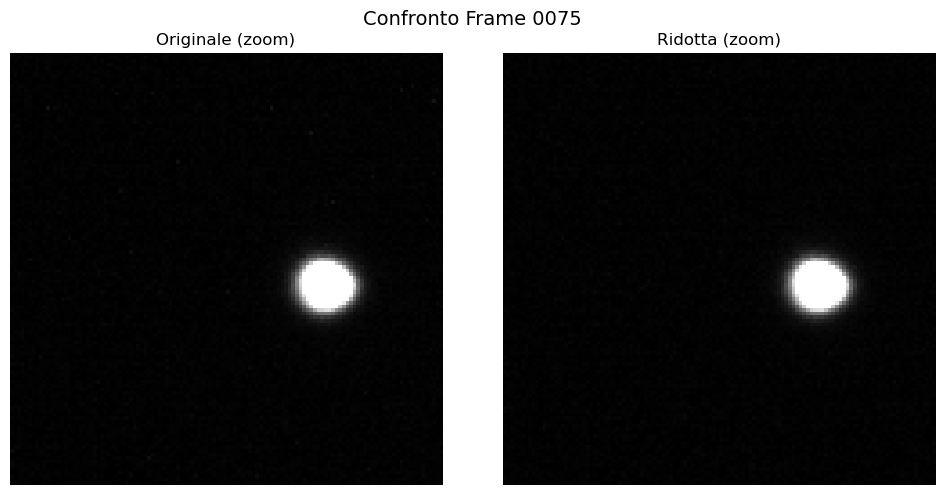

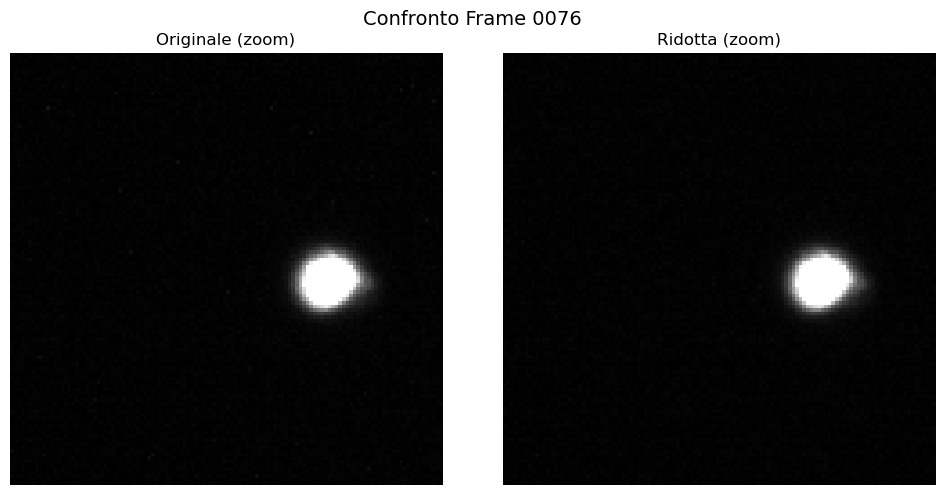

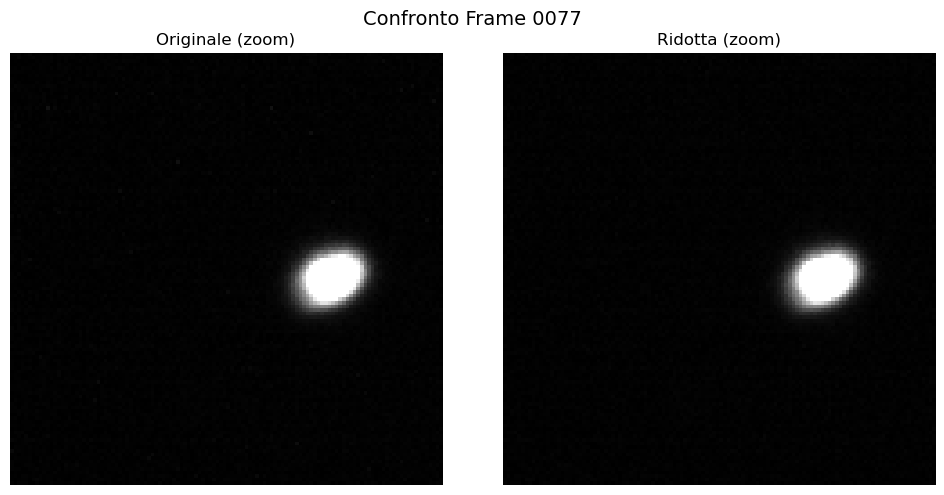

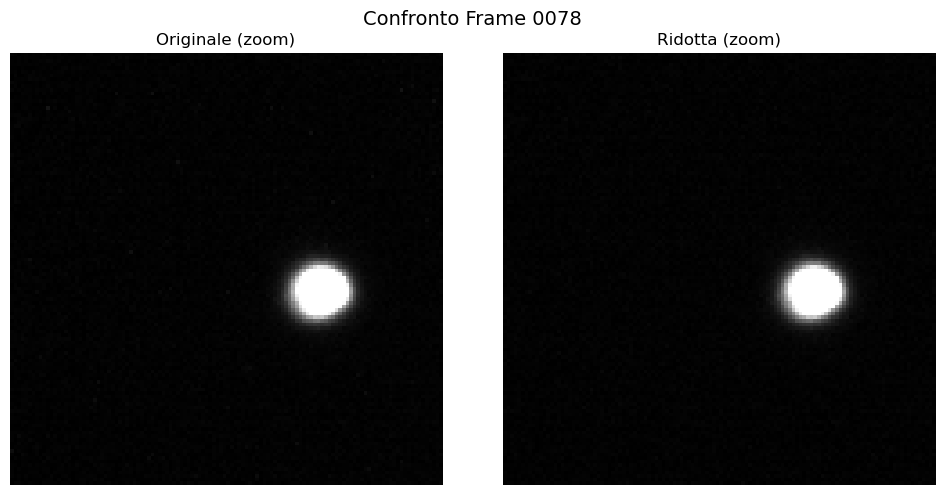

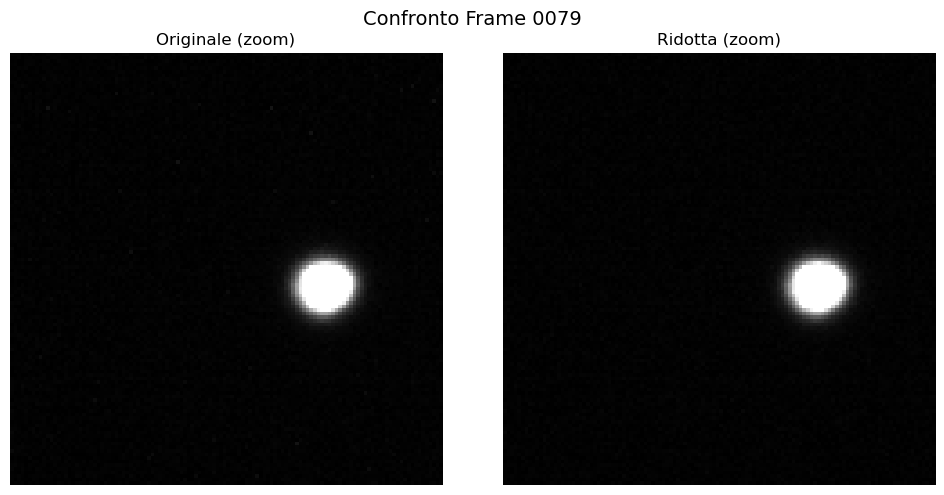

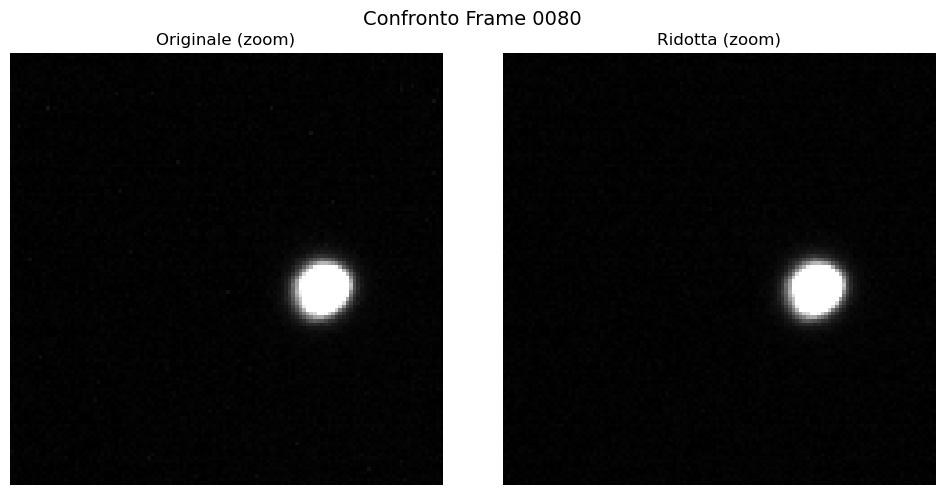

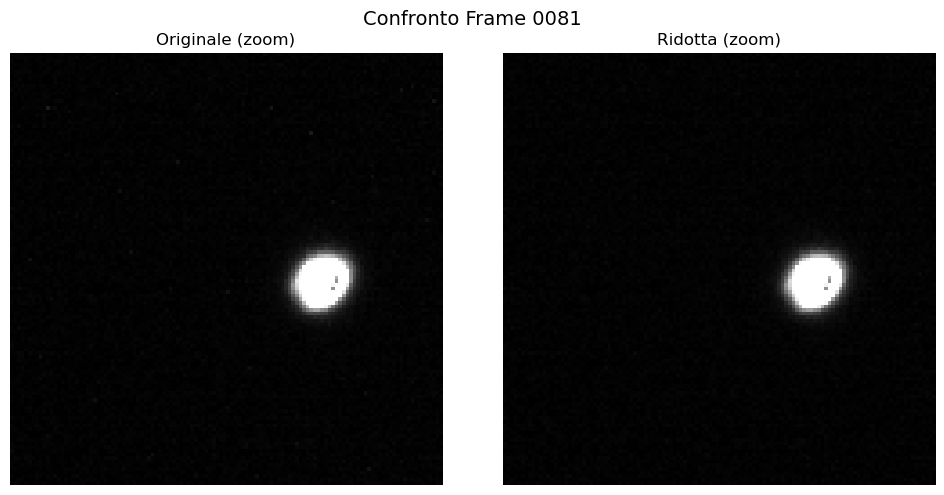

Frame 0081 è un outlier!


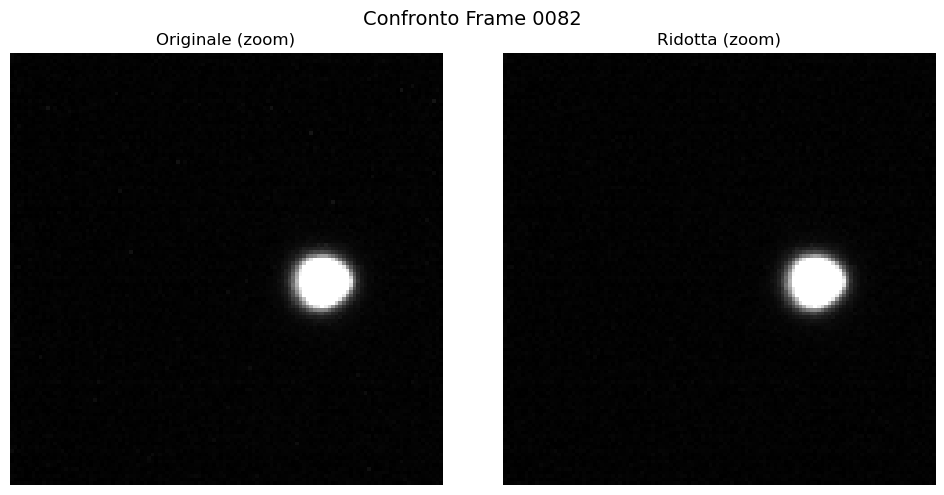

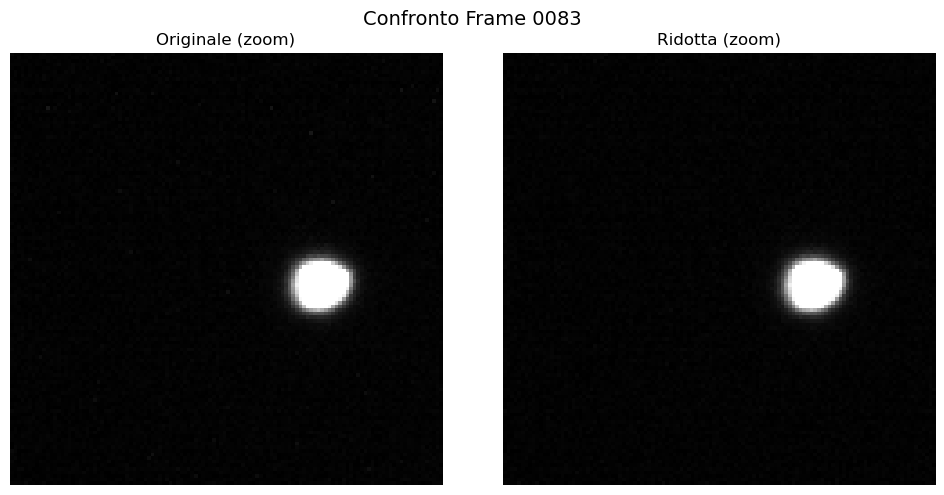

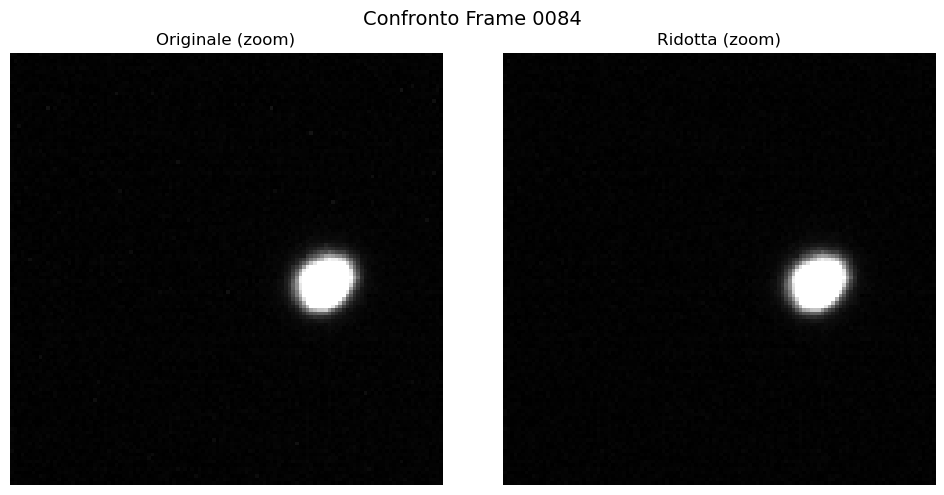

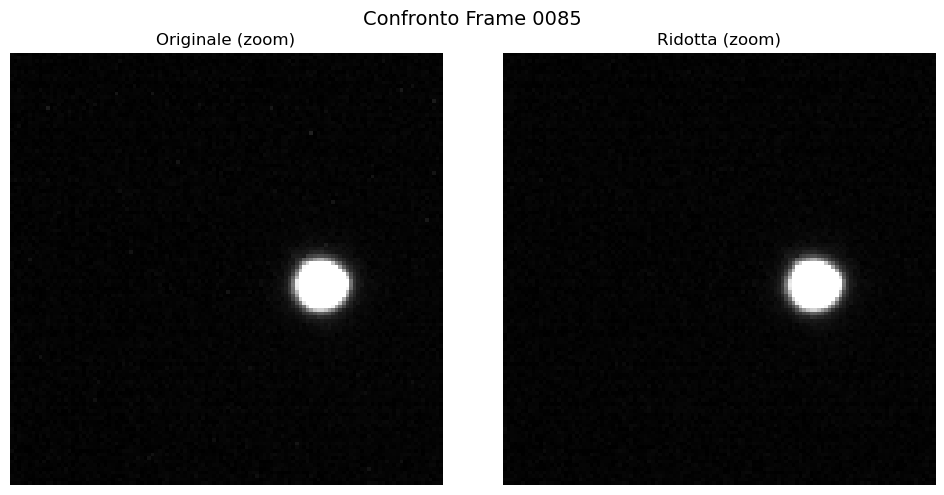

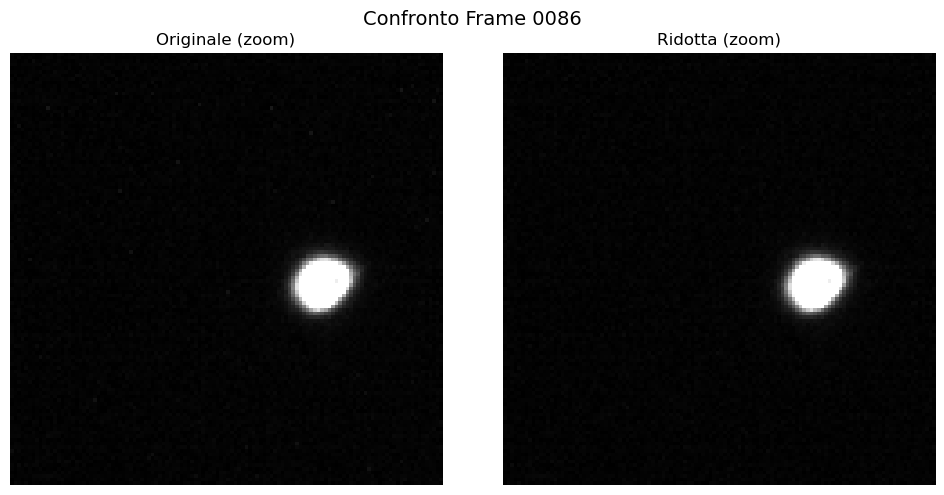

Frame 0086 è un outlier!


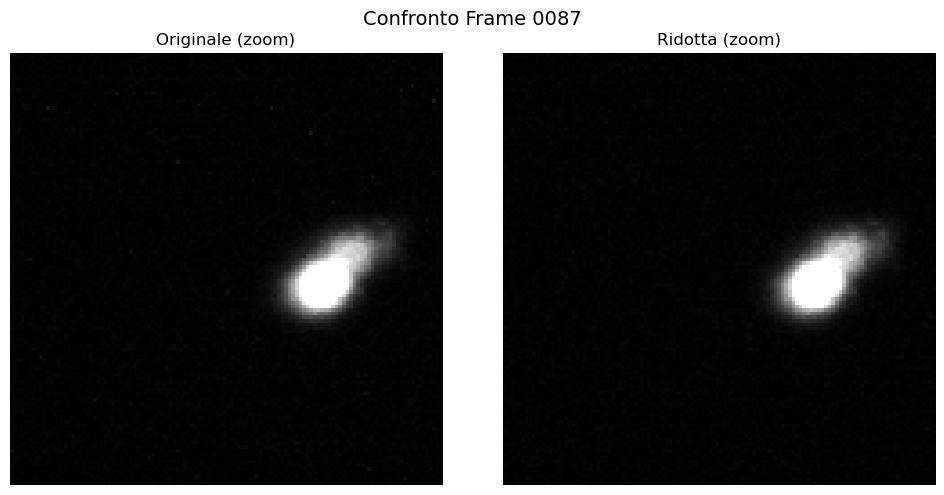

Frame 0087 è un outlier!


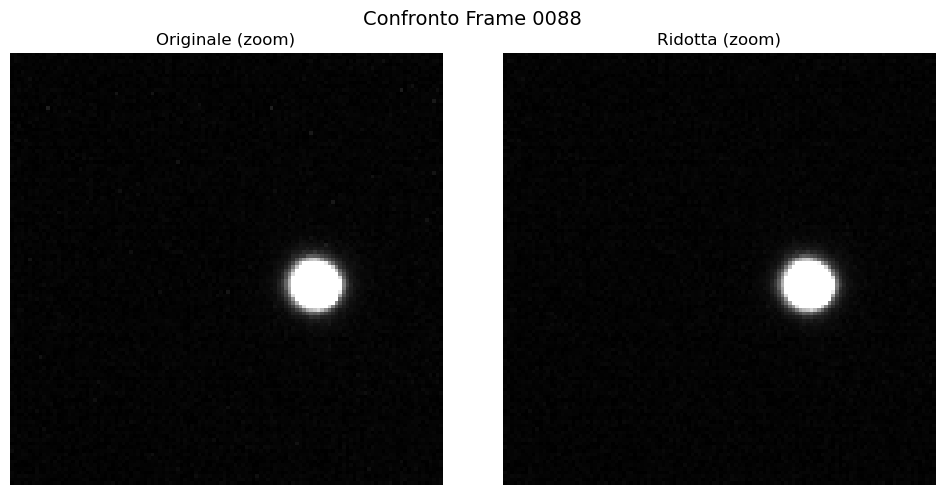

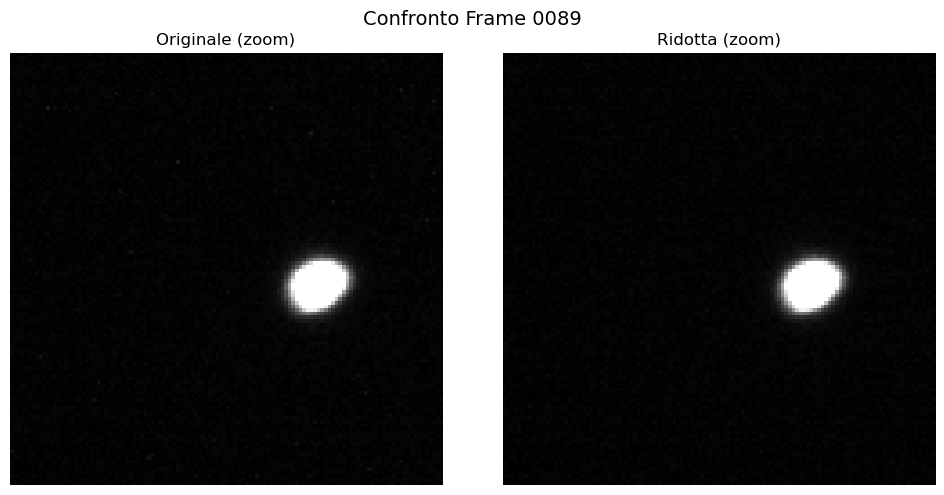

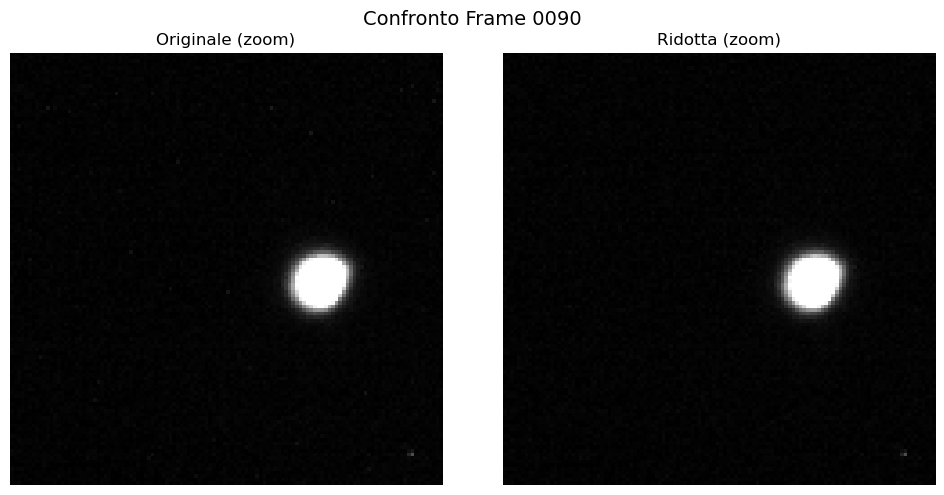

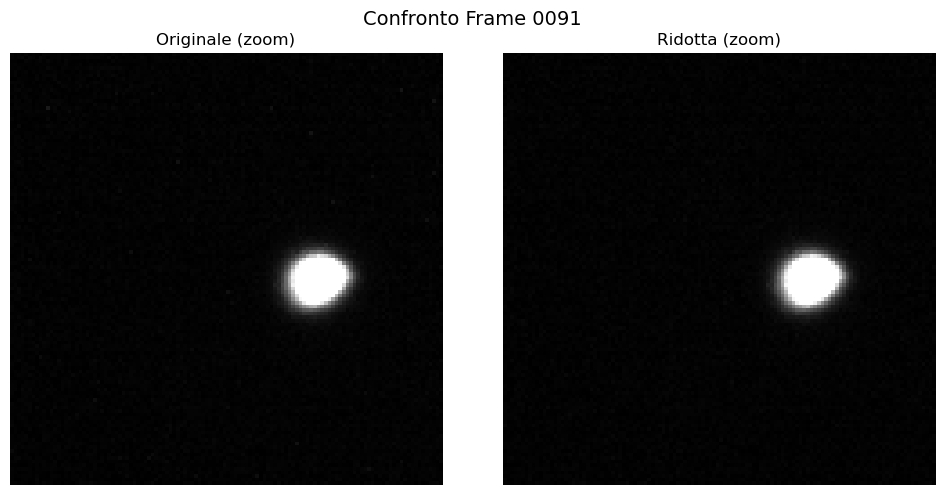

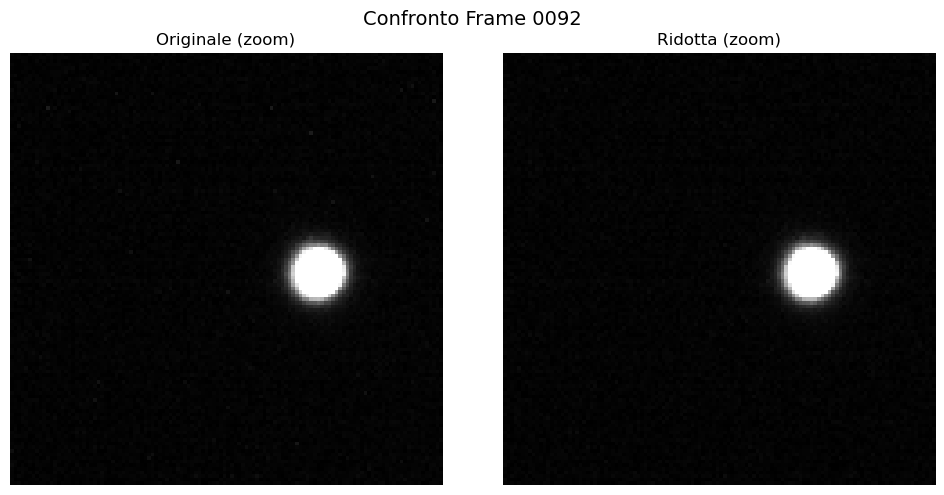

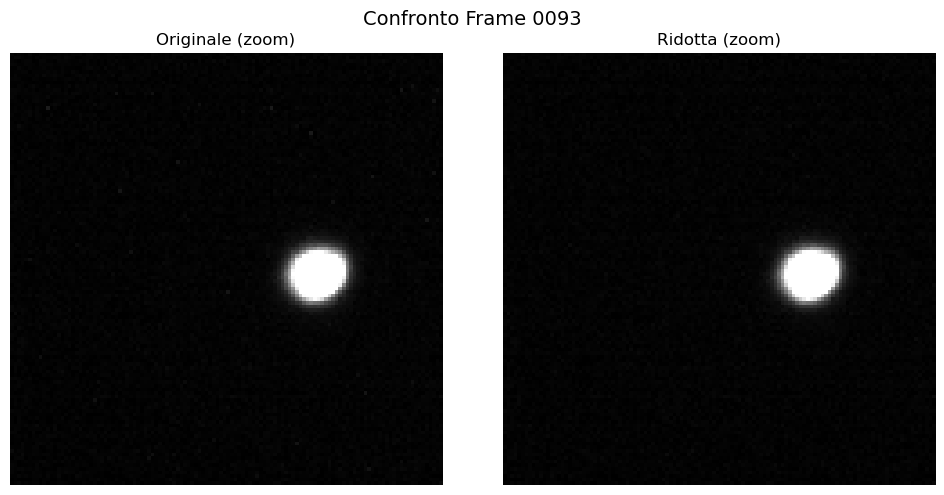

Frame 0093 è un outlier!


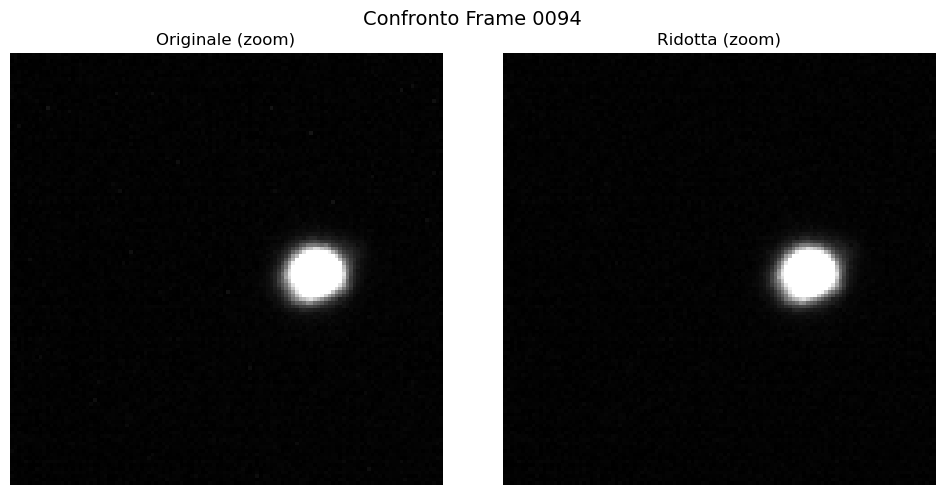

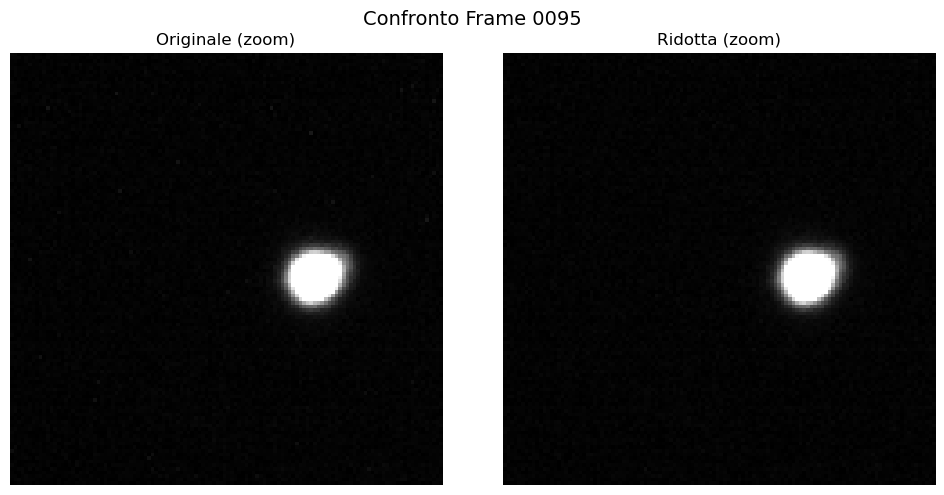

Frame 0095 è un outlier!


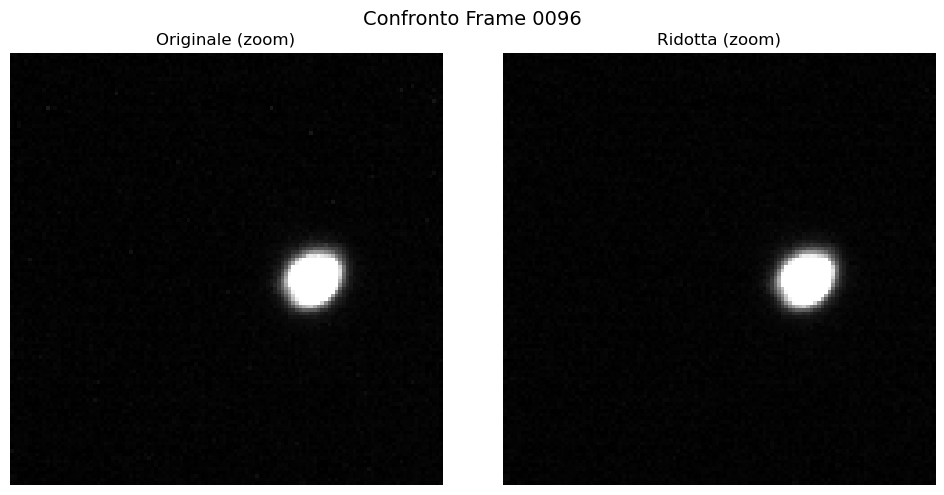

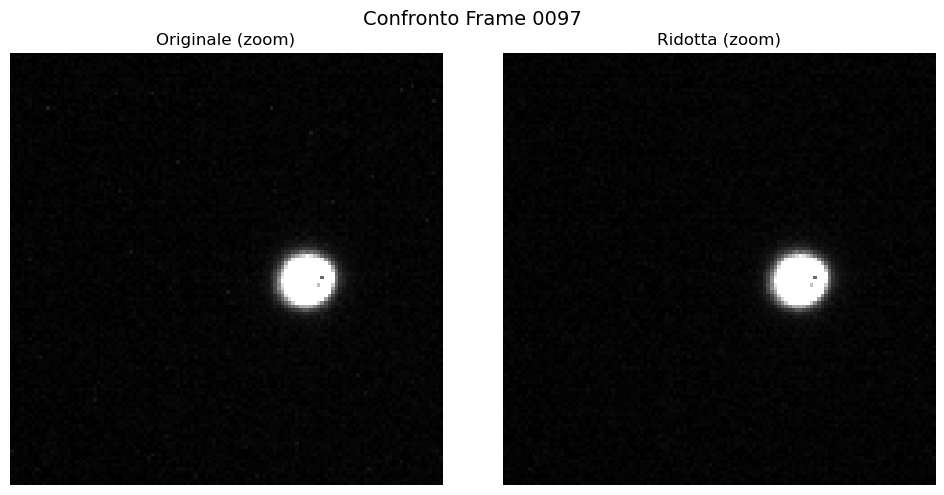

Frame 0097 è un outlier!


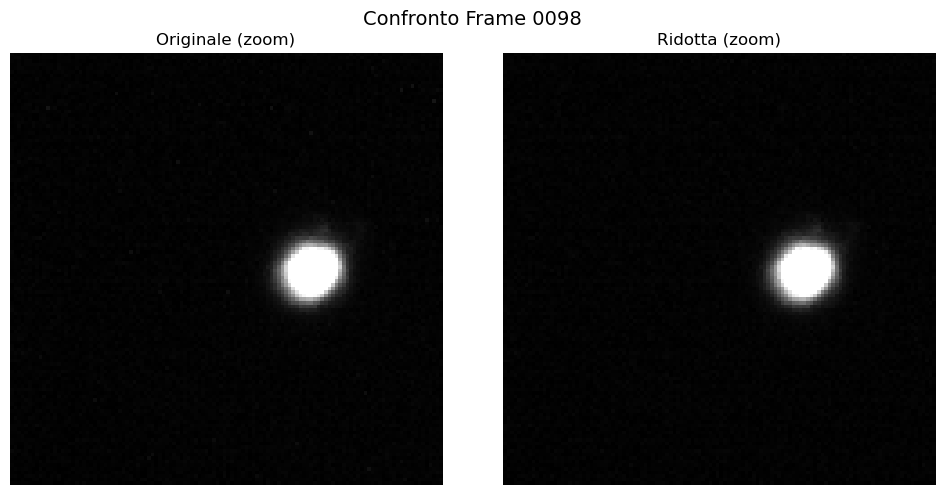

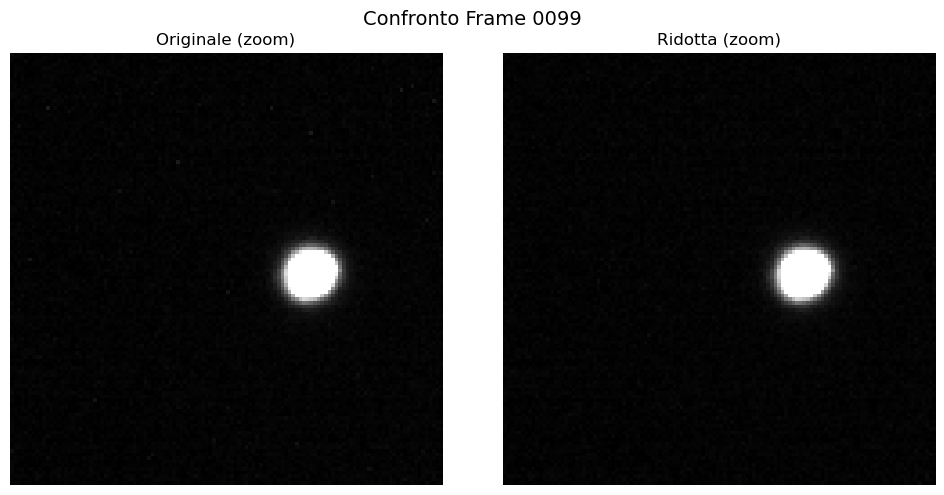

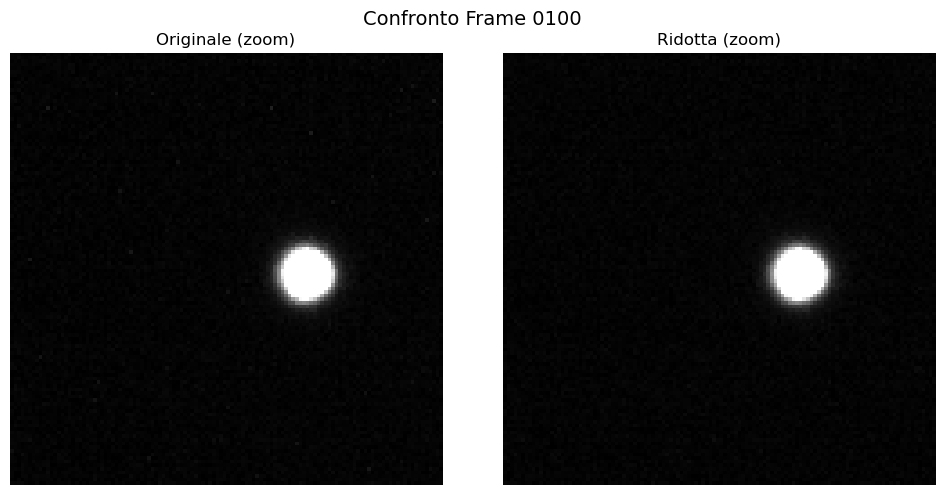

In [17]:
#ZOOM DEI PRIMI 100 FRAME

import os
import numpy as np
import matplotlib.pyplot as plt

# Intervallo di taglio per zoom sulla regione del target
x_range = (550, 670)
y_range = (800, 920)

# Funzione per estrarre la sottoimmagine
def extract_subimage(image, x_range, y_range):
    return image[y_range[0]:y_range[1], x_range[0]:x_range[1]]

# Lista di frame outlier (esempio, sostituisci con la tua lista effettiva)
outlier_frames = [3, 9, 12, 20, 22, 23, 24, 33, 64, 66, 74, 81, 86, 87, 93, 95, 97]

# Funzione per caricare un'immagine FITS
def load_image(directory, filename):
    path = os.path.join(directory, filename)
    with fits.open(path) as hdul:
        return hdul[0].data.astype(np.float64)

# Carica le immagini originali e ridotte per i frame fino a 100
for frame in range(1, 101):
    original_name = f'SZ_Lyn-{frame:04d}_R.fit'
    reduced_name = f'SZ_Lyn-{frame:04d}_reduced.fit'

    try:
        original = extract_subimage(load_image(original_dir, original_name), x_range, y_range)
        reduced = extract_subimage(load_image(reduced_dir, reduced_name), x_range, y_range)

        # Plot affiancato delle sottoimmagini
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        fig.suptitle(f'Confronto Frame {frame:04d}', fontsize=14)

        axes[0].imshow(original, cmap='gray', origin='lower', 
                       vmin=np.percentile(original, 5), vmax=np.percentile(original, 99))
        axes[0].set_title('Originale (zoom)')
        axes[0].axis('off')

        axes[1].imshow(reduced, cmap='gray', origin='lower', 
                       vmin=np.percentile(reduced, 5), vmax=np.percentile(reduced, 99))
        axes[1].set_title('Ridotta (zoom)')
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

        # Verifica se il frame è un outlier e stampa un messaggio
        if frame in outlier_frames:
            print(f"Frame {frame:04d} è un outlier!")

    except FileNotFoundError as e:
        print(f"File mancante: {e}")

Analizzando i frame ridotti e originali, si osserva che i punti che non seguono la curva di luce non sono causati dalla riduzione dei dati, poiché il problema è già presente nell’immagine originale. L’errore sembra derivare da due possibili cause, che si manifestano in tutti i frame analizzati (una o l’altra):

1.	Messa a fuoco imperfetta dell’oggetto: Quando l’oggetto non è a fuoco perfetto, l’immagine risulta più sfocata. In questo caso, sebbene il raggio dell’apertura rimanga invariato, la quantità di luce raccolta diminuisce, poiché i fotoni diventano più sparpagliati. Di conseguenza, la misurazione del flusso risulta più bassa rispetto ai frame correttamente messi a fuoco.
2.	Presenza di pixel neri o più scuri nell’area dell’oggetto: In alcuni frame, ci sono pixel neri o più scuri in corrispondenza dell’oggetto, che appaiono come una diminuzione del flusso. Questo potrebbe essere dovuto a difetti nel sensore o a fluttuazioni nel flusso di fotoni, con alcuni pixel che non registrano correttamente la luce, risultando in un calo apparente del flusso in quelle specifiche aree.


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 178.64it/s]


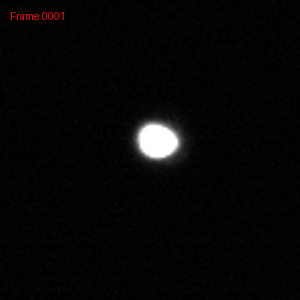

In [21]:
#CREAZIONE DI UNA GIF CON I PRIMI 100 FRAME

import os
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from tqdm import tqdm
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Image as IPImage
import io

# --- FUNZIONI BASE ---
def load_image(directory, filename):
    path = os.path.join(directory, filename)
    with fits.open(path) as hdul:
        return hdul[0].data.astype(np.float64)

def extract_subimage(image, x_range, y_range):
    return image[y_range[0]:y_range[1], x_range[0]:x_range[1]]

# --- PARAMETRI ---
reduced_dir = "/Users/claudiamurro/Desktop/laboratorio tecnologie astronomiche/cupani/reduced"
x_range = (550, 670)
y_range = (800, 920)
n_frames = 100
output_frames = []

# Font per annotazioni
try:
    font = ImageFont.truetype("DejaVuSans-Bold.ttf", 18)
except IOError:
    font = ImageFont.load_default()

# --- CREAZIONE DELLA GIF IN MEMORIA ---

for i in tqdm(range(1, n_frames + 1)):
    fname = f'SZ_Lyn-{i:04d}_reduced.fit'

    try:
        image = load_image(reduced_dir, fname)
        subimage = extract_subimage(image, x_range, y_range)

        # Normalizzazione per visualizzazione
        norm = (subimage - np.nanpercentile(subimage, 5)) / (np.nanpercentile(subimage, 99) - np.nanpercentile(subimage, 5))
        norm = np.clip(norm, 0, 1)
        frame = (norm * 255).astype(np.uint8)

        # Converti in immagine PIL, ridimensiona e annota
        pil_image = Image.fromarray(frame).convert("RGB").resize((300, 300))
        draw = ImageDraw.Draw(pil_image)
        draw.text((10, 10), f"Frame {i:04d}", font=font, fill=(255, 0, 0))

        output_frames.append(pil_image)

    except FileNotFoundError:
        print(f"File mancante: {fname}")
        continue

# --- VISUALIZZA GIF NEL NOTEBOOK ---
gif_bytes = io.BytesIO()
output_frames[0].save(gif_bytes, format="GIF", save_all=True,
                      append_images=output_frames[1:], duration=500, loop=0)
gif_bytes.seek(0)

display(IPImage(data=gif_bytes.getvalue()))